<a href="https://colab.research.google.com/github/hiren14/Human_Detection_Alert/blob/main/college_atten.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Custom Training with YOLOv5

In this tutorial, we assemble a dataset and train a custom YOLOv5 model to recognize the objects in our dataset. To do so we will take the following steps:

* Gather a dataset of images and label our dataset
* Export our dataset to YOLOv5
* Train YOLOv5 to recognize the objects in our dataset
* Evaluate our YOLOv5 model's performance
* Run test inference to view our model at work



![](https://uploads-ssl.webflow.com/5f6bc60e665f54545a1e52a5/615627e5824c9c6195abfda9_computer-vision-cycle.png)

# Step 1: Install Requirements

In [1]:
#clone YOLOv5 and 
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 12142, done.
remote: Total 12142 (delta 0), reused 0 (delta 0), pack-reused 12142
Receiving objects: 100% (12142/12142), 12.55 MiB | 11.46 MiB/s, done.
Resolving deltas: 100% (8364/8364), done.
/content/yolov5
     |████████████████████████████████| 1.6 MB 50.0 MB/s 
     |████████████████████████████████| 145 kB 42.8 MB/s 
     |████████████████████████████████| 178 kB 60.9 MB/s 
     |████████████████████████████████| 1.1 MB 53.3 MB/s 
     |████████████████████████████████| 67 kB 5.0 MB/s 
     |████████████████████████████████| 54 kB 1.9 MB/s 
     |████████████████████████████████| 138 kB 52.2 MB/s 
     |████████████████████████████████| 62 kB 1.7 MB/s 
Setup complete. Using torch 1.12.1+cu113 (Tesla T4)


# Step 2: Assemble Our Dataset



In [2]:
from roboflow import Roboflow
rf = Roboflow(model_format="yolov5", notebook="ultralytics")

upload and label your dataset, and get an API KEY here: https://app.roboflow.com/?model=yolov5&ref=ultralytics


In [3]:
# set up environment
os.environ["DATASET_DIRECTORY"] = "/content/datasets"

In [ ]:
#after following the link above, recieve python code with these fields filled in
#from roboflow import Roboflow
#rf = Roboflow(api_key="YOUR API KEY HERE")
#project = rf.workspace().project("YOUR PROJECT")
#dataset = project.version("YOUR VERSION").download("yolov5")

Extracting Dataset Version Zip to /content/datasets/American-Mushrooms-1 in yolov5pytorch:: 100%|██████████| 278/278 [00:00<00:00, 1046.33it/s]


In [4]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="0HUcbTKUsURom17OTih9")
project = rf.workspace("hiren").project("gecp_project")
dataset = project.version(1).download("yolov5")

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to /content/datasets/gecp_project-1 in yolov5pytorch:: 100%|██████████| 70/70 [00:00<00:00, 847.93it/s]


In [ ]:
dataset

# Step 3: Train Our Custom YOLOv5 model

Here, we are able to pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** Our dataset locaiton is saved in the `dataset.location`
- **weights:** specify a path to weights to start transfer learning from. Here we choose the generic COCO pretrained checkpoint.
- **cache:** cache images for faster training

In [ ]:
%cd 

/root


# Evaluate Custom YOLOv5 Detector Performance
Training losses and performance metrics are saved to Tensorboard and also to a logfile.

If you are new to these metrics, the one you want to focus on is `mAP_0.5` - learn more about mean average precision [here](https://blog.roboflow.com/mean-average-precision/).

In [16]:
!python train.py --img 416 --batch 16 --epochs 550 --data /content/datasets/gecp_project-1/data.yaml --weights yolov5s.pt --cache

train: weights=yolov5s.pt, cfg=, data=/content/datasets/gecp_project-1/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=1650, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.2-82-gc91d1db Python-3.7.13 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_

In [6]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

#Run Inference  With Trained Weights
Run inference with a pretrained checkpoint on contents of `test/images` folder downloaded from Roboflow.

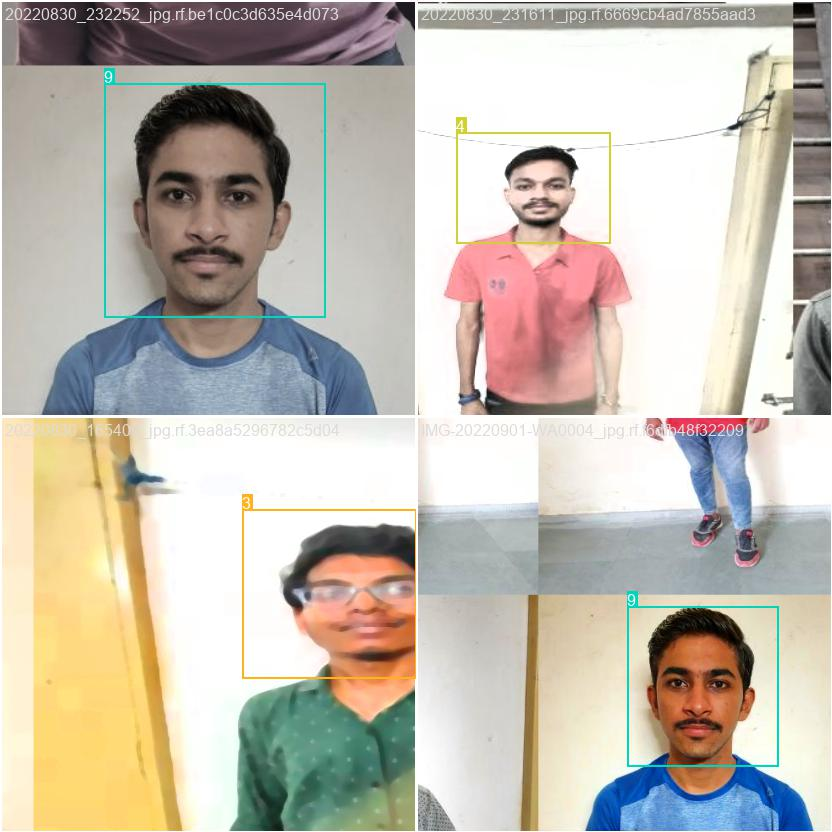

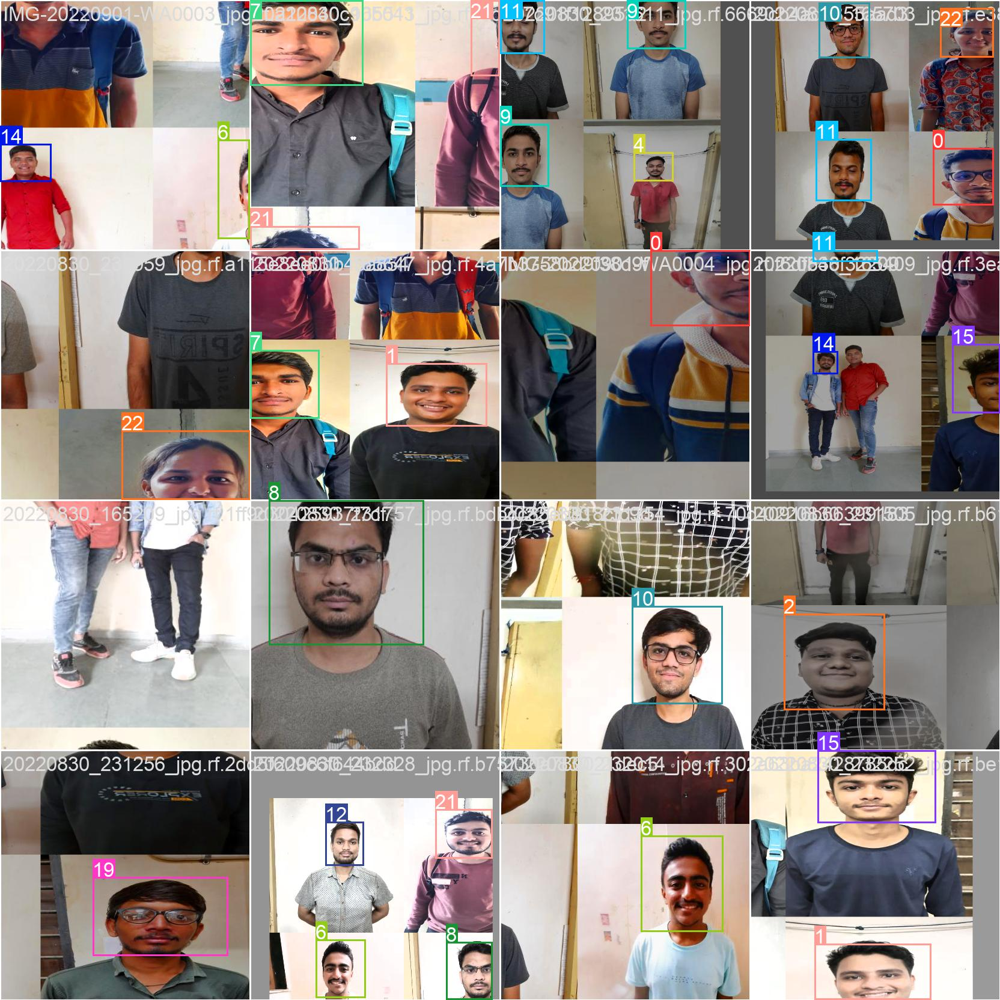

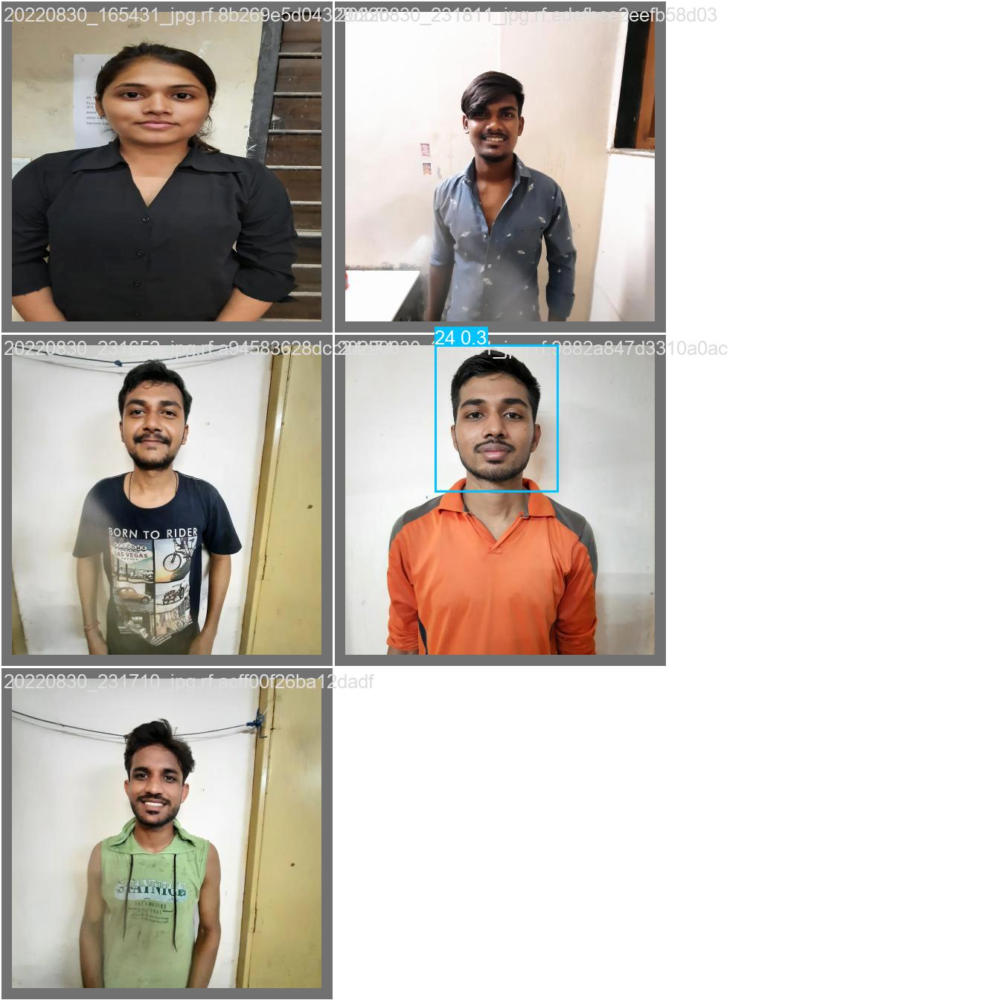

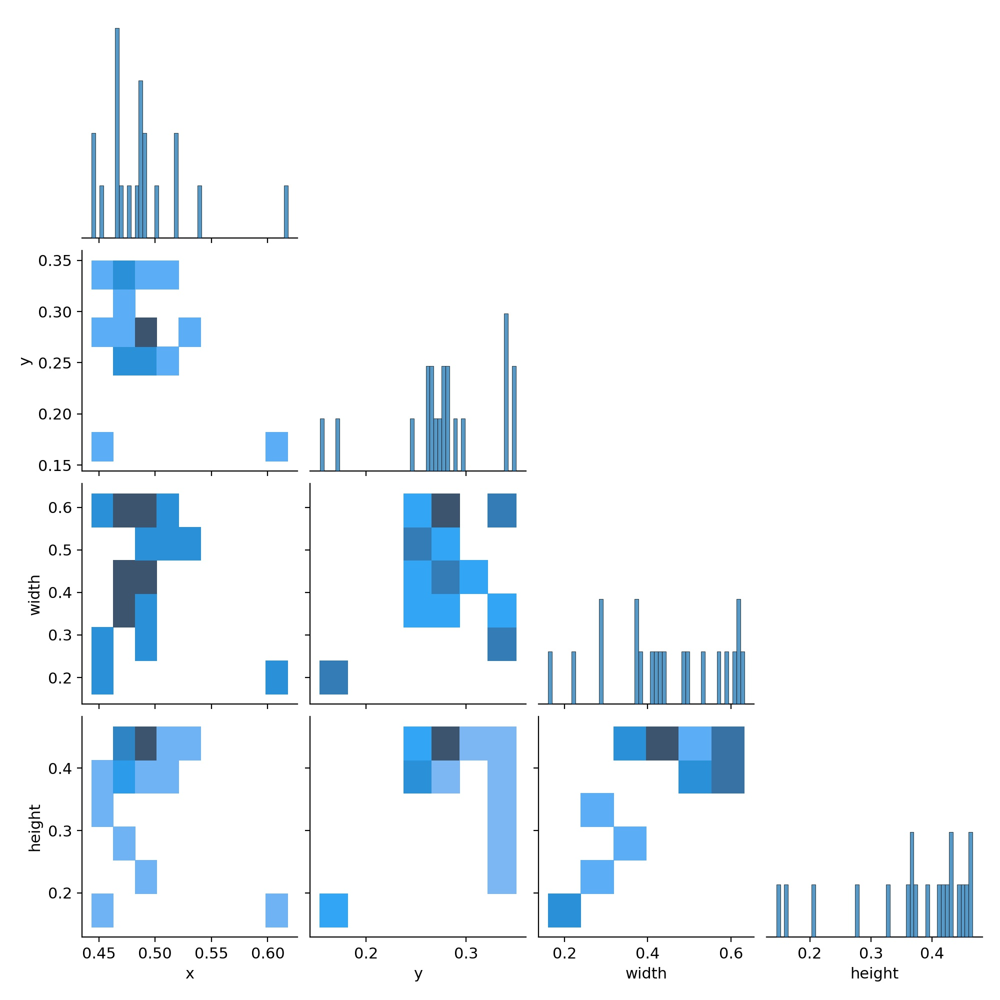

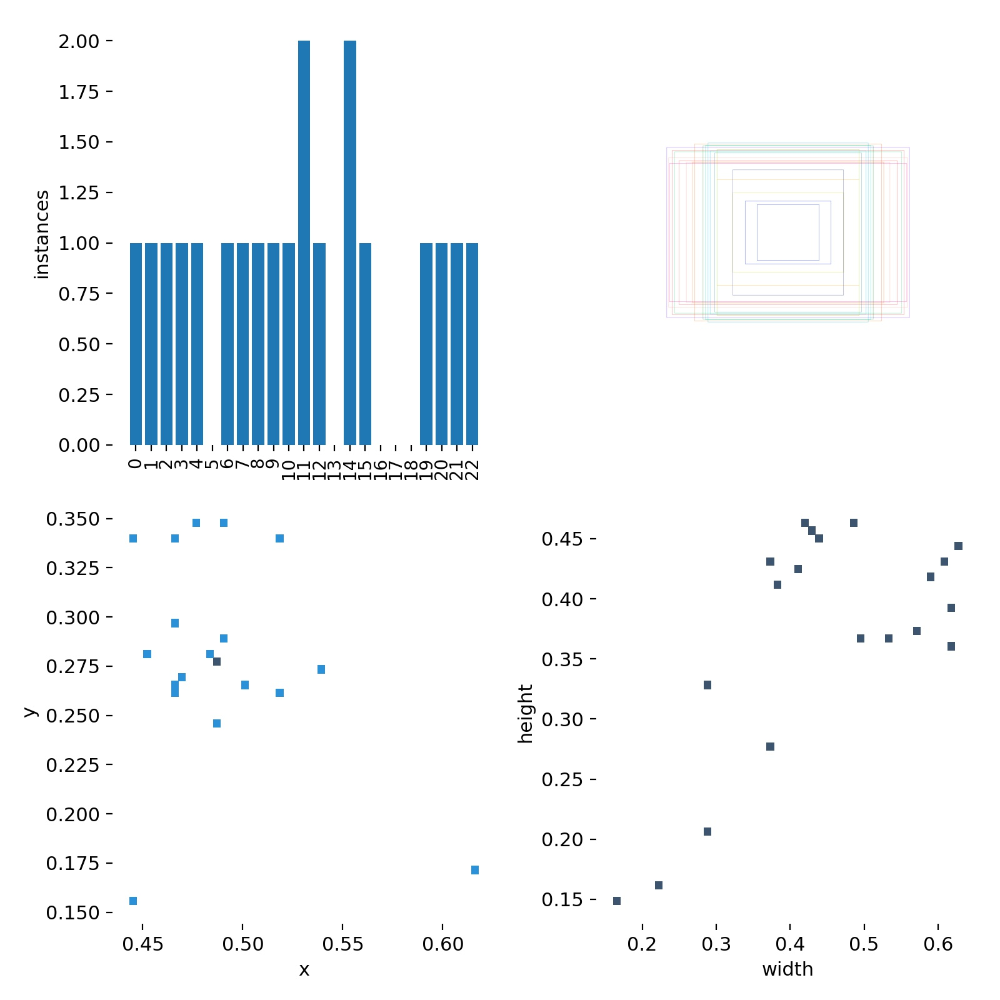

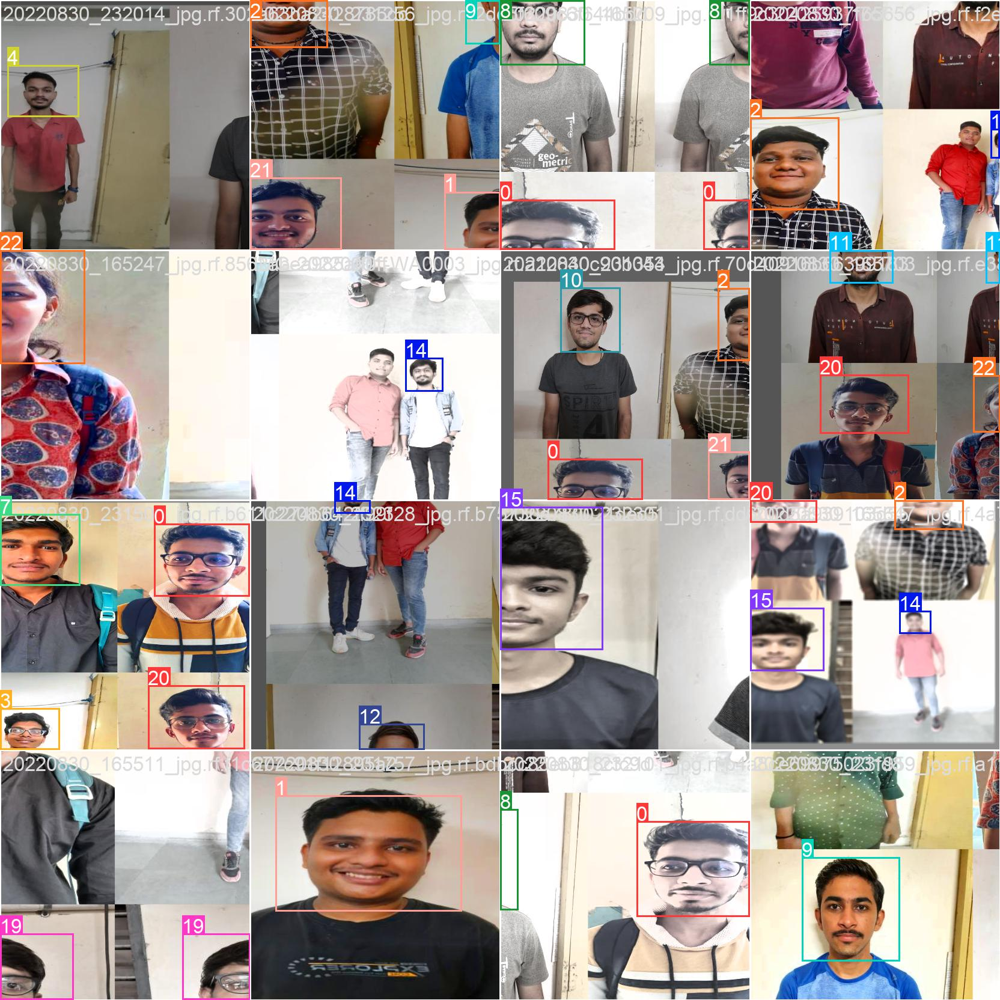

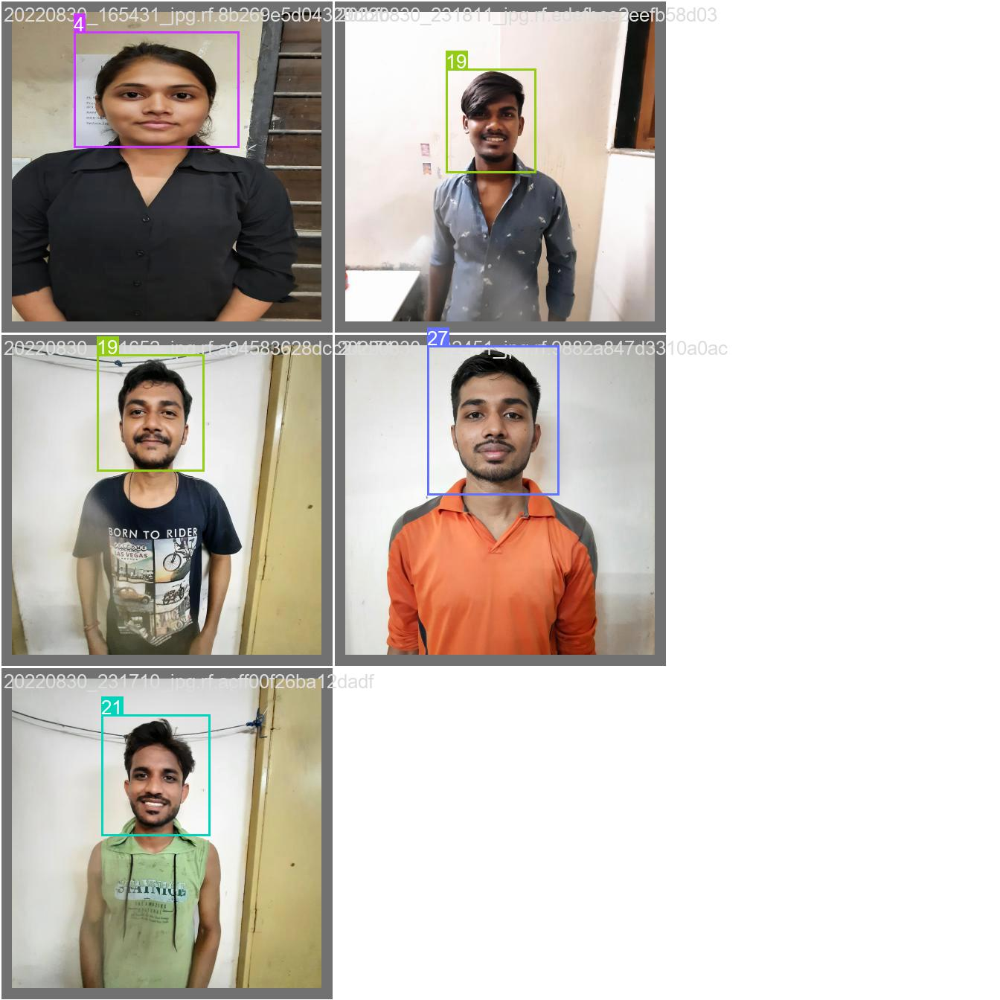

In [7]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/train/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [14]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 416 --conf 0.1 --source /content/datasets/gecp_project-1/train/images/

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/datasets/gecp_project-1/train/images/, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.2-82-gc91d1db Python-3.7.13 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 213 layers, 7072156 parameters, 0 gradients, 15.9 GFLOPs
image 1/20 /content/datasets/gecp_project-1/train/images/20220830_165209_jpg.rf.1ff9c30425937f7cfb7b2df4fb45dfc7.jpg: 416x416 1 1, 1 3, 8.2ms
image 2/20 /content/datasets/gecp_project-1/train/images/20220830_165247_jpg.rf.8562abea985aff0ff20710fbdbcd72d2.jpg: 416x416 1 1, 1 2, 1 24, 1 3, 8.4ms
image 3/20 /content/datasets/gecp_projec

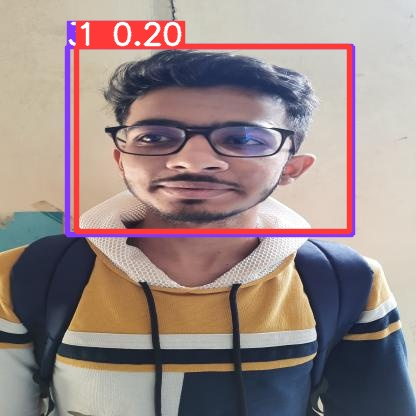

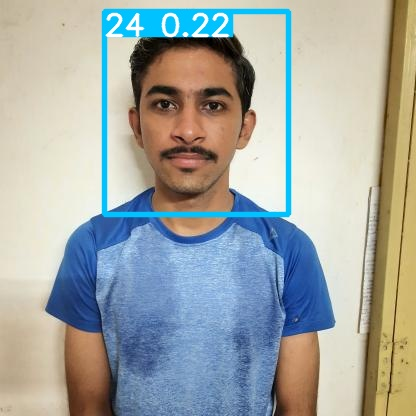

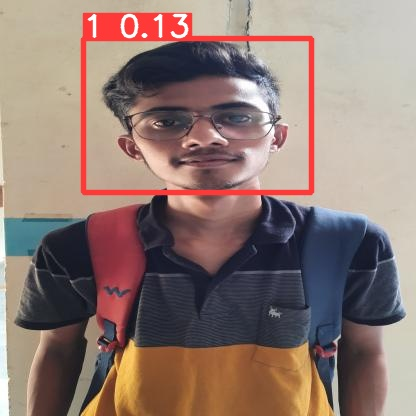

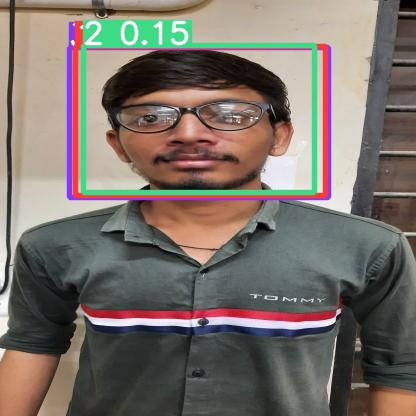

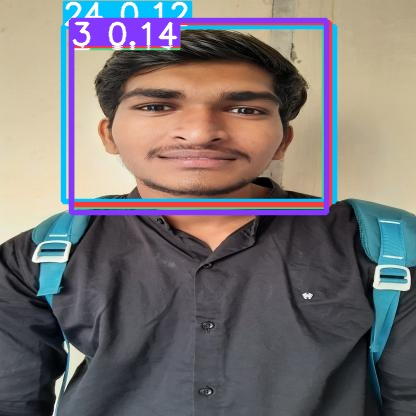

...

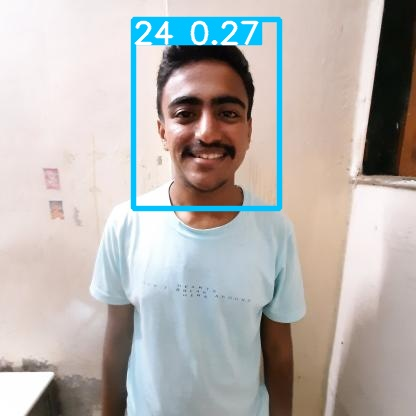

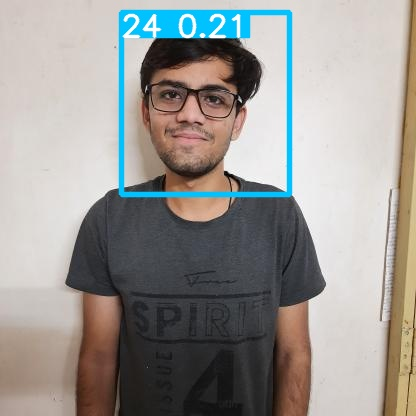

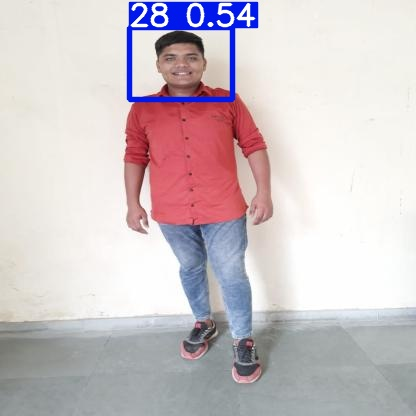

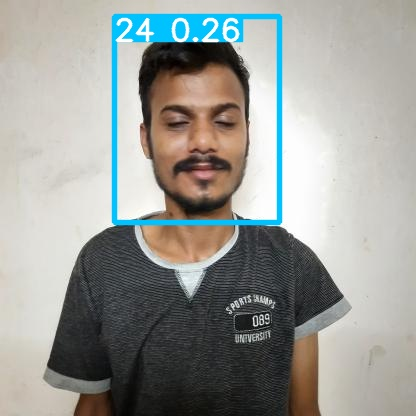

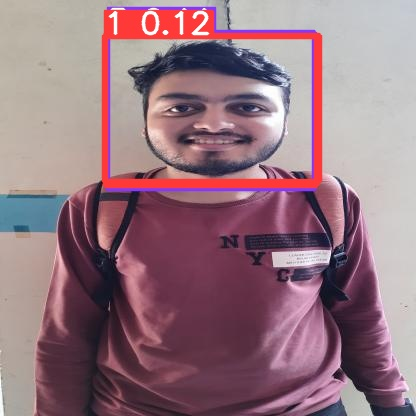

In [15]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp4/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# Conclusion and Next Steps

Congratulations! You've trained a custom YOLOv5 model to recognize your custom objects.

To improve you model's performance, we recommend first interating on your datasets coverage and quality. See this guide for [model performance improvement](https://github.com/ultralytics/yolov5/wiki/Tips-for-Best-Training-Results).

To deploy your model to an application, see this guide on [exporting your model to deployment destinations](https://github.com/ultralytics/yolov5/issues/251).

Once your model is in production, you will want to continually iterate and improve on your dataset and model via [active learning](https://blog.roboflow.com/what-is-active-learning/).

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/pkg_resources/_vendor/packaging/version.py", line 56, in parse
    return Version(version)
  File "/usr/local/lib/python3.7/dist-packages/pkg_resources/_vendor/packaging/version.py", line 277, in __init__
    raise InvalidVersion("Invalid version: '{0}'".format(version))
pkg_resources.extern.packaging.version.InvalidVersion: Invalid version: '/usr/local/lib/python3.7/dist'

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "detect.py", line 42, in <module>
    from models.common import DetectMultiBackend
  File "/content/yolov5/yolov5/models/common.py", line 23, in <module>
    from utils.dataloaders import exif_transpose, letterbox
  File "/content/yolov5/yolov5/utils/dataloaders.py", line 31, in <module>
  File "/content/yolov5/yolov5/utils/augmentations.py", line 15, in <module>
    from utils.general import LOGGER, check_version, colorstr, r

## re run

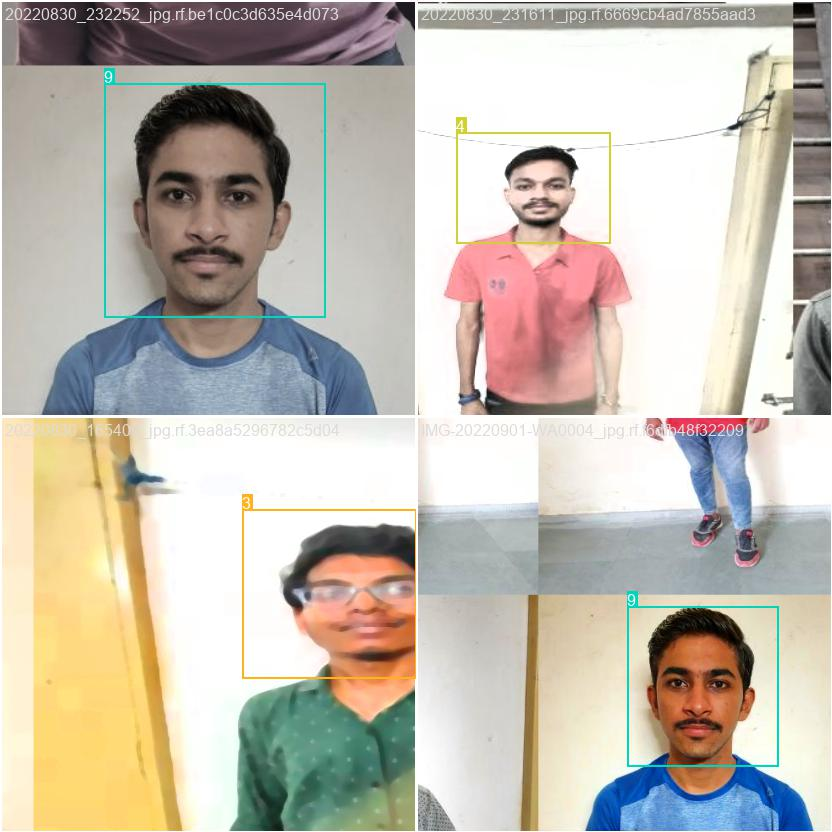

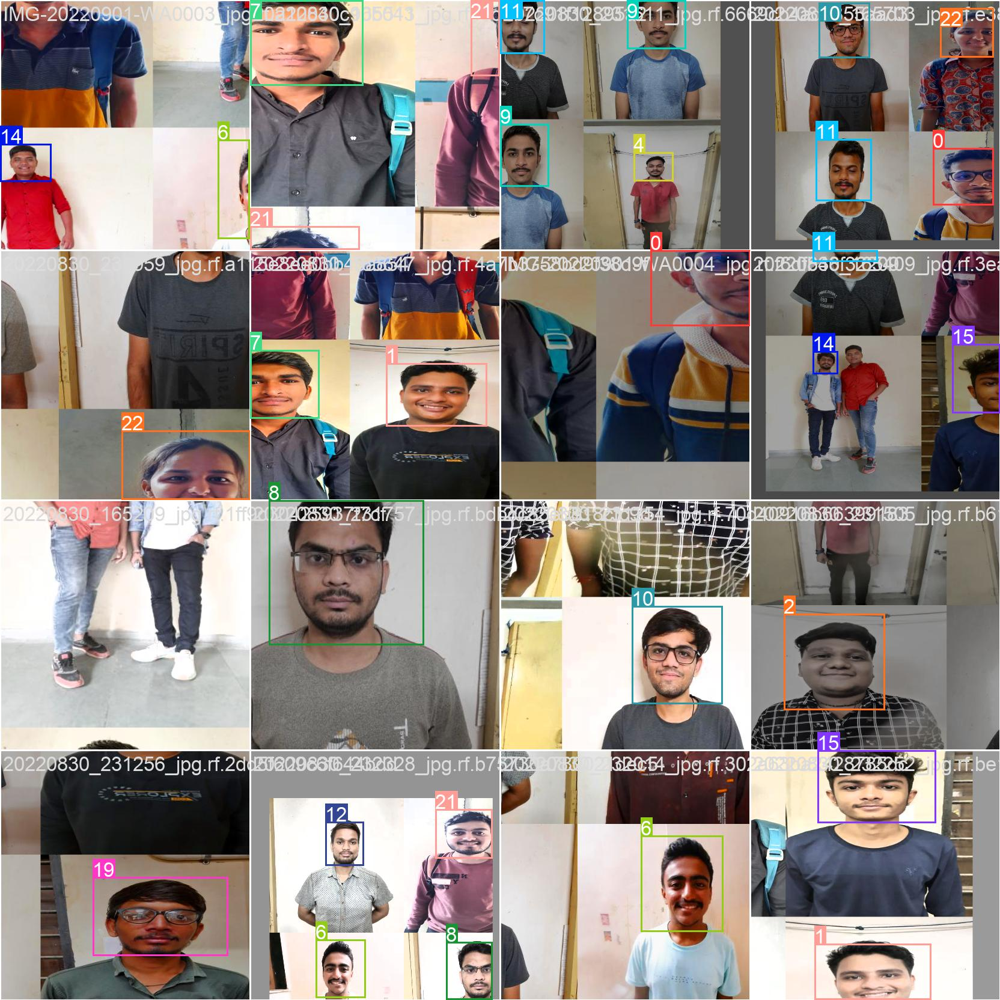

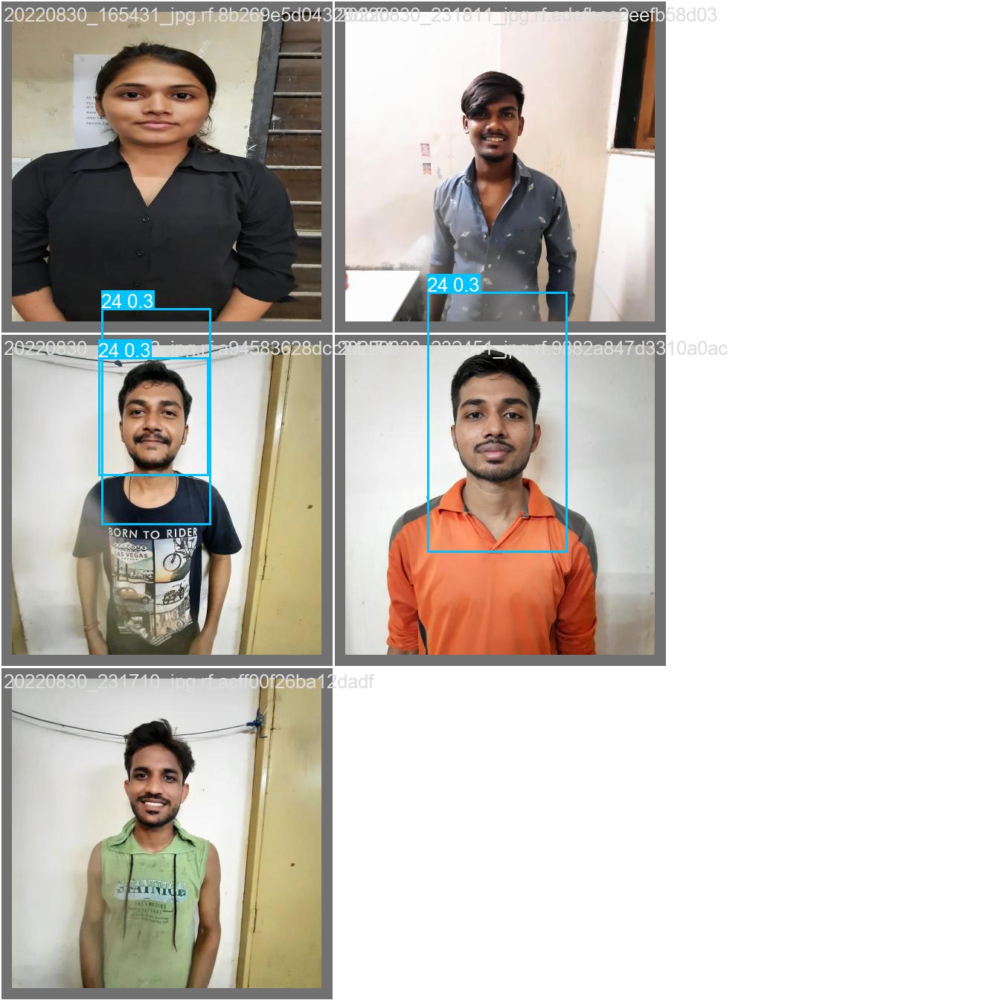

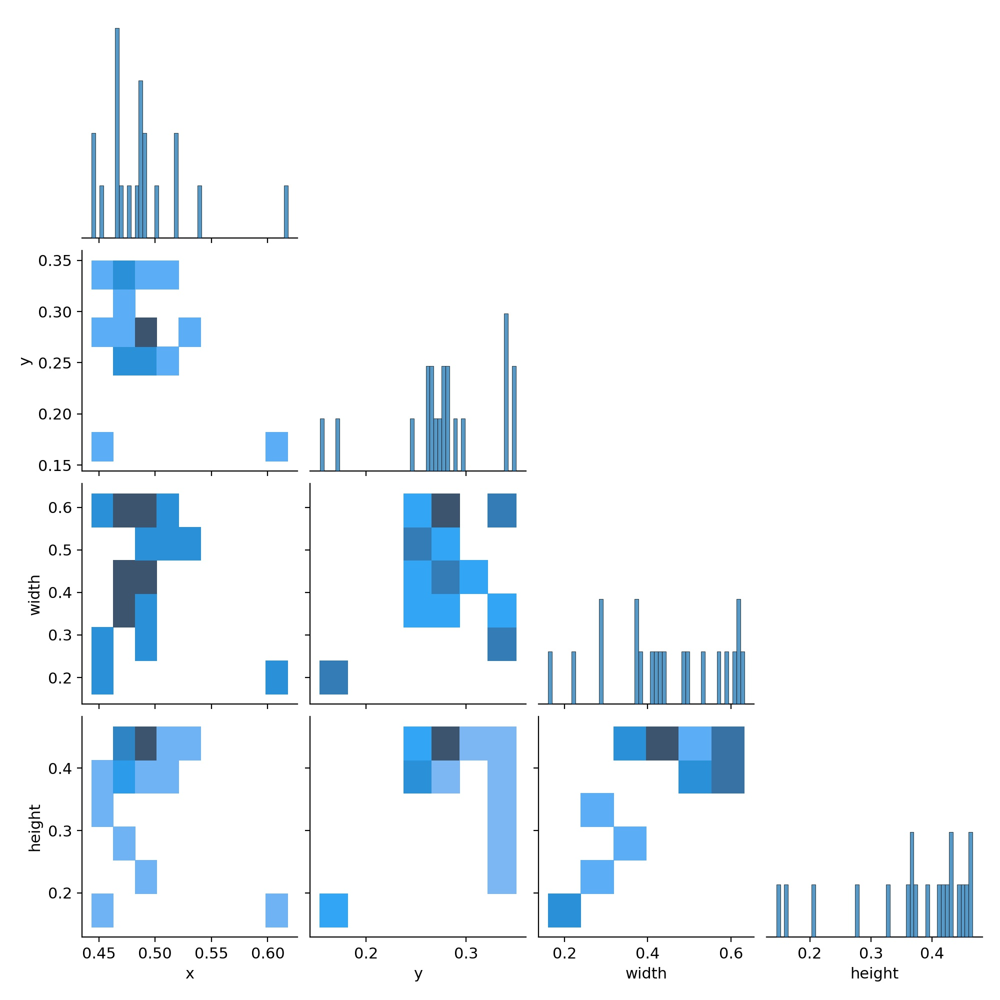

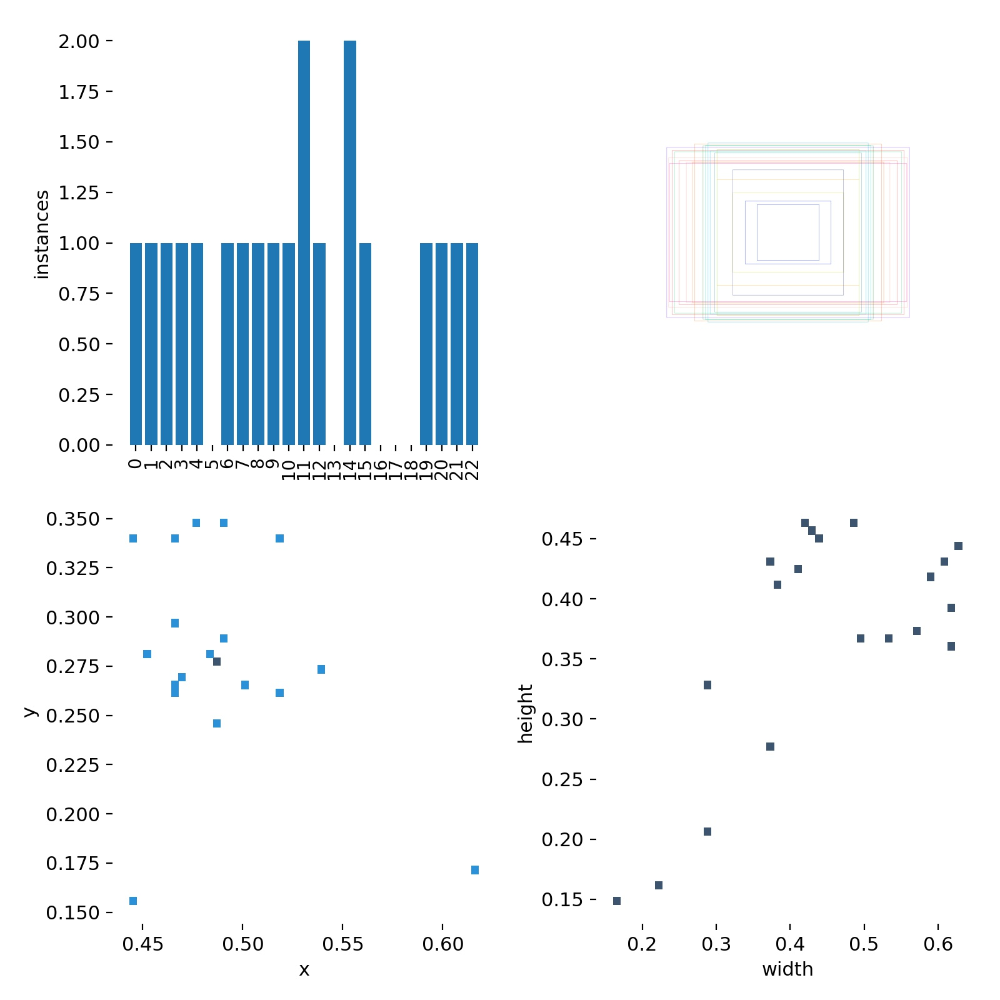

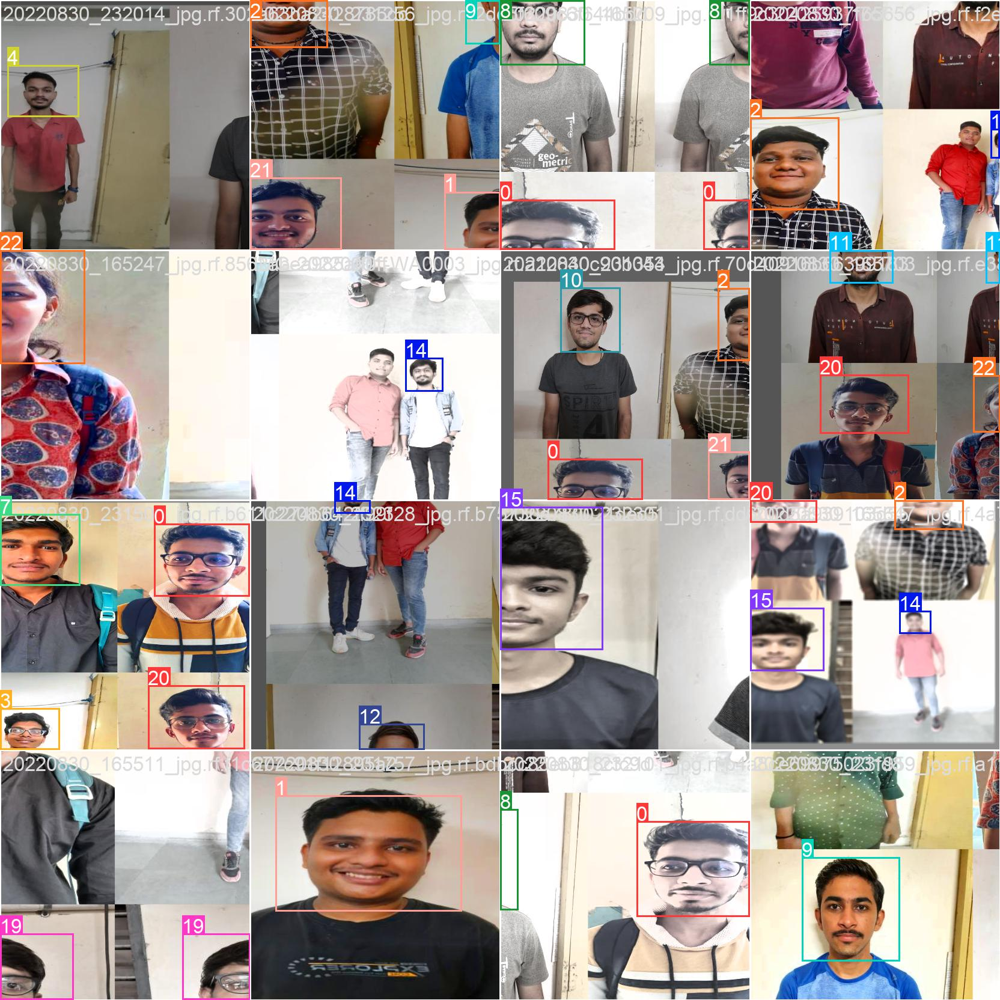

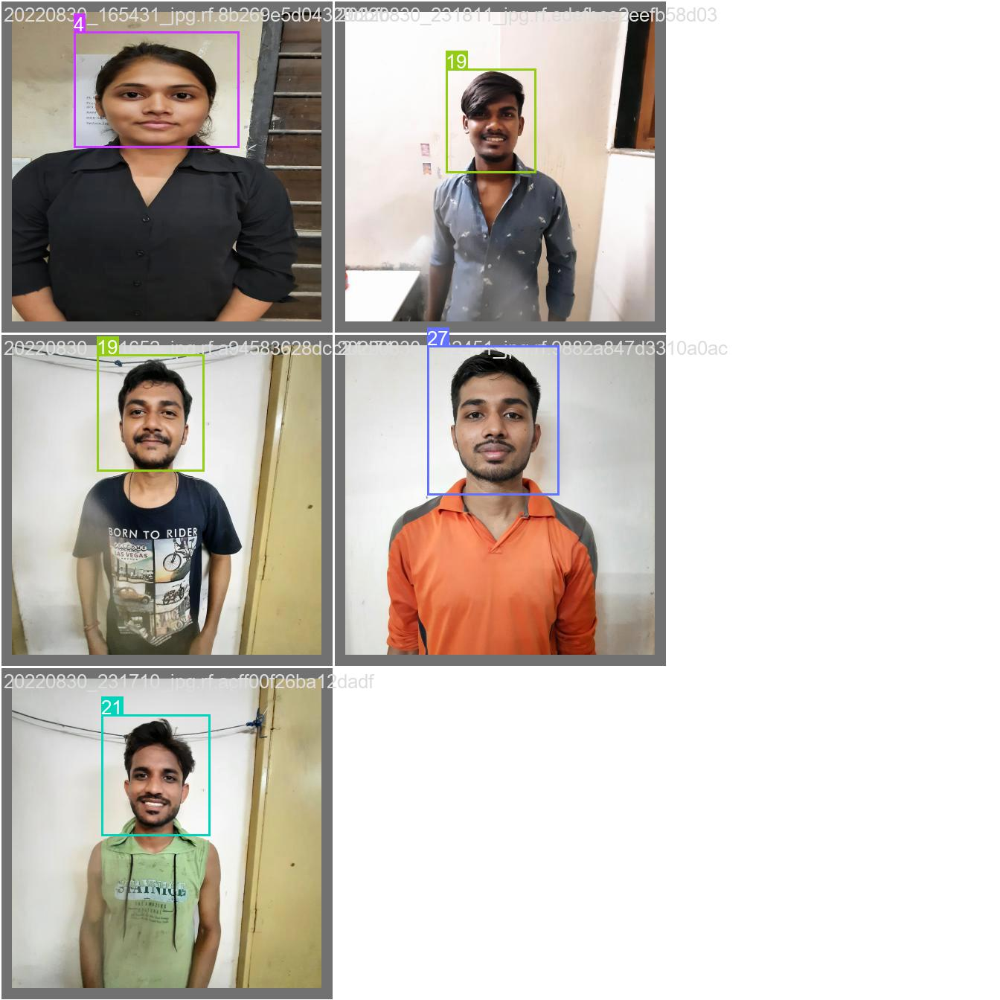

In [17]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/train/exp3/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [18]:
!python detect.py --weights runs/train/exp3/weights/best.pt --img 416 --conf 0.1 --source /content/datasets/gecp_project-1/train/images/

detect: weights=['runs/train/exp3/weights/best.pt'], source=/content/datasets/gecp_project-1/train/images/, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.2-82-gc91d1db Python-3.7.13 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 213 layers, 7072156 parameters, 0 gradients, 15.9 GFLOPs
image 1/20 /content/datasets/gecp_project-1/train/images/20220830_165209_jpg.rf.1ff9c30425937f7cfb7b2df4fb45dfc7.jpg: 416x416 1 1, 1 3, 9.4ms
image 2/20 /content/datasets/gecp_project-1/train/images/20220830_165247_jpg.rf.8562abea985aff0ff20710fbdbcd72d2.jpg: 416x416 1 3, 8.3ms
image 3/20 /content/datasets/gecp_project-1/train/image

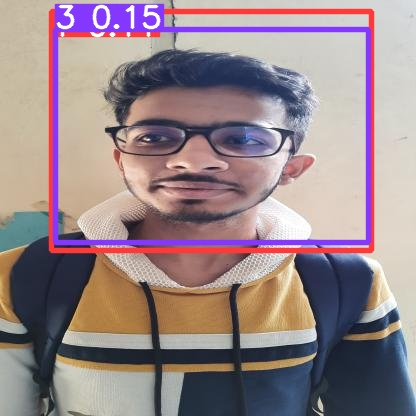

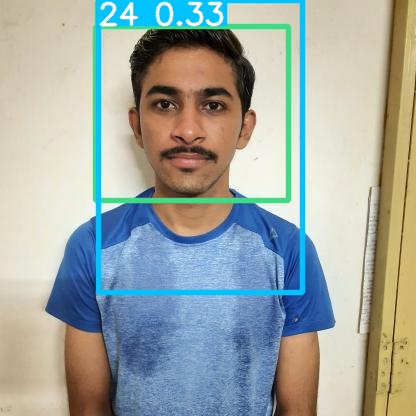

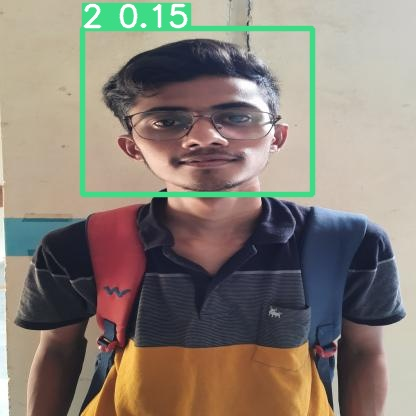

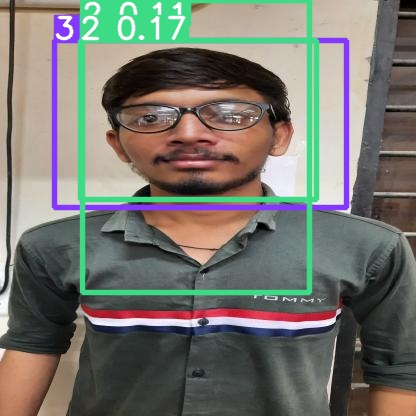

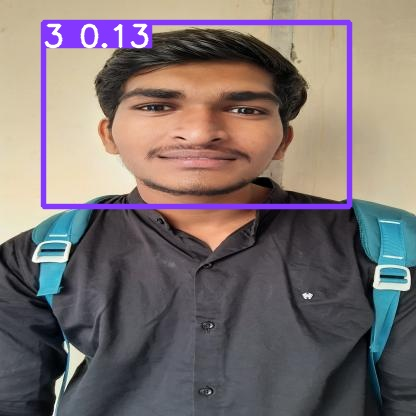

...

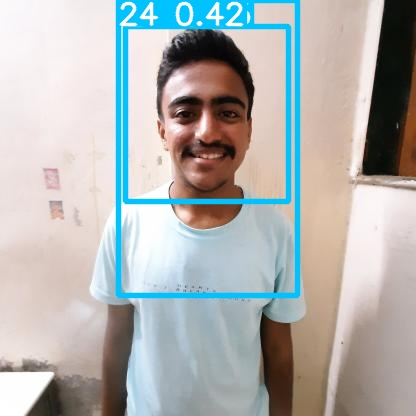

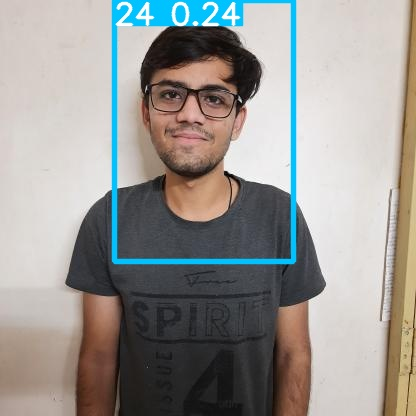

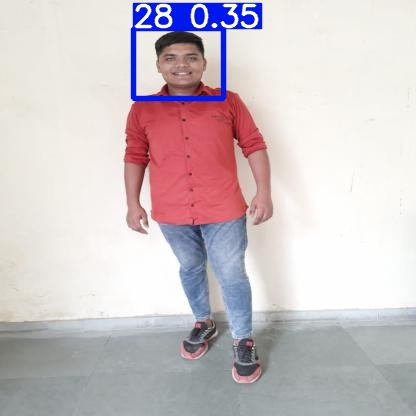

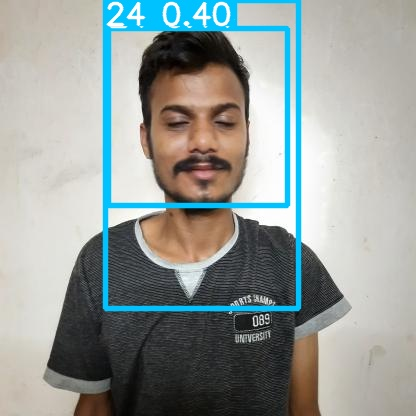

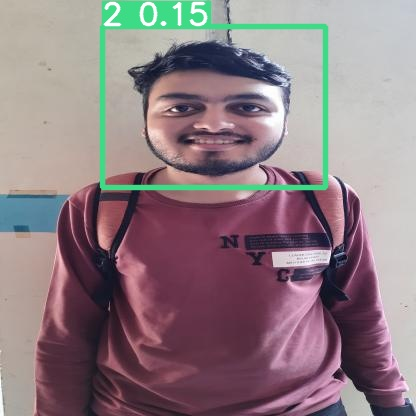

In [19]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp5/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# with large model and more layer 

In [20]:

!python train.py --img 416 --batch 16 --epochs 550 --data /content/datasets/gecp_project-1/data.yaml --weights yolov5l.pt --cache

train: weights=yolov5l.pt, cfg=, data=/content/datasets/gecp_project-1/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=550, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.2-82-gc91d1db Python-3.7.13 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h

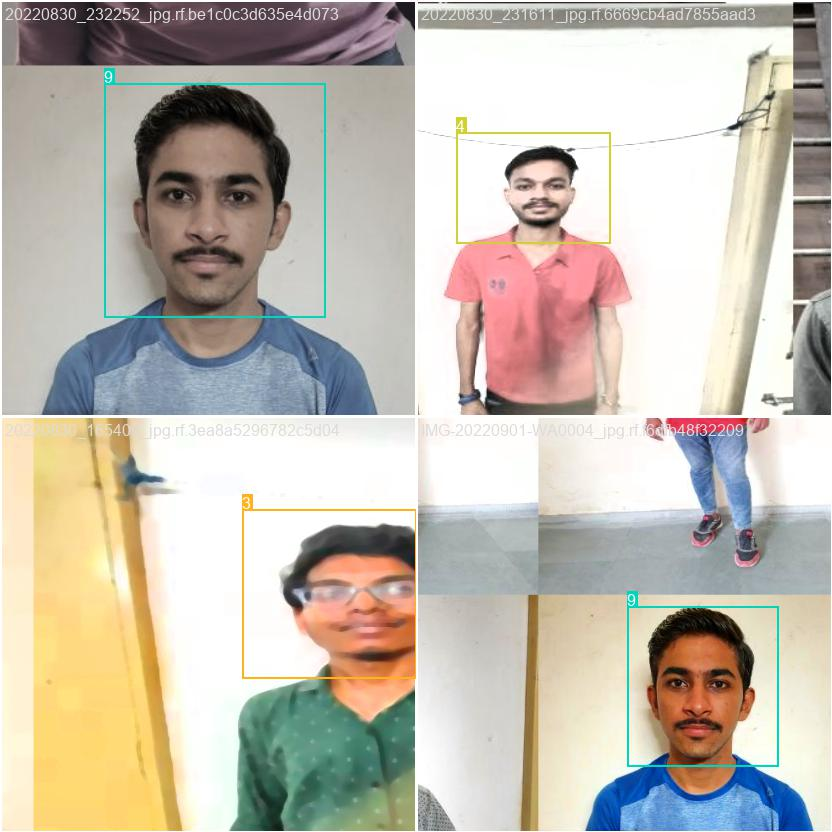

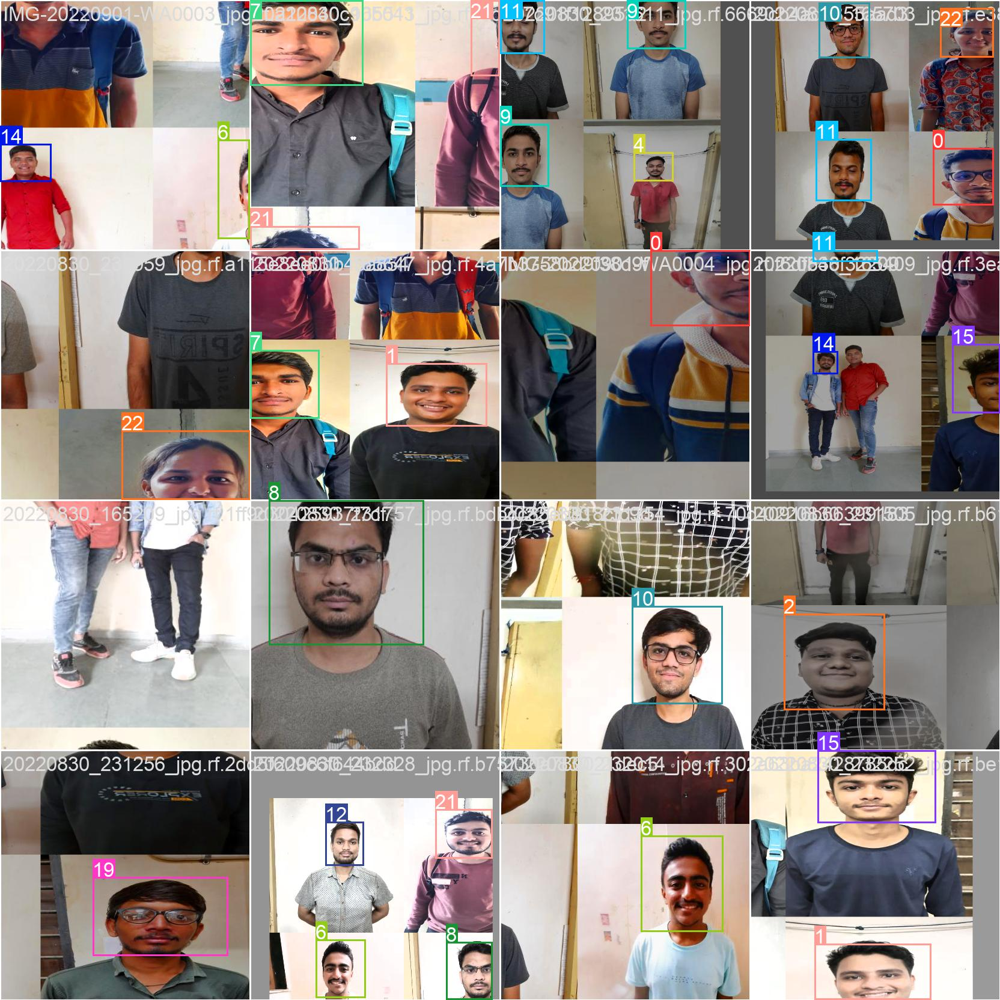

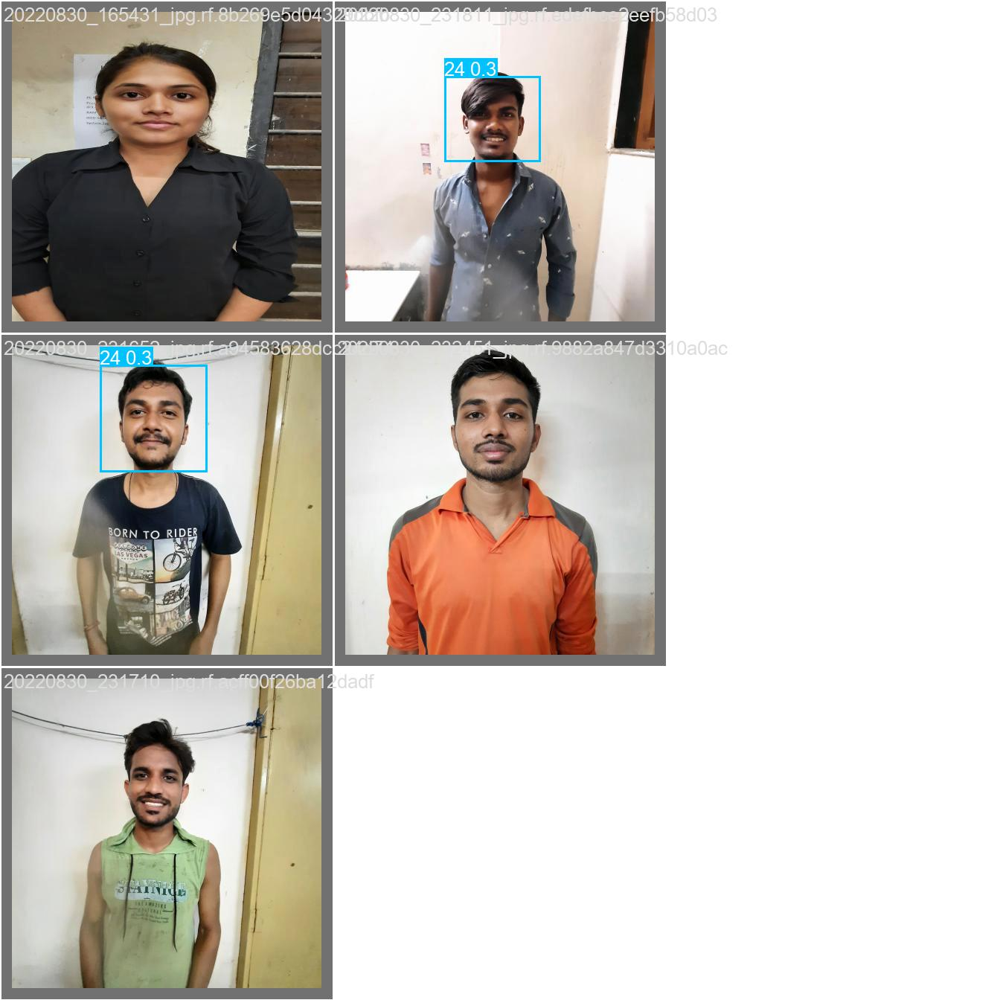

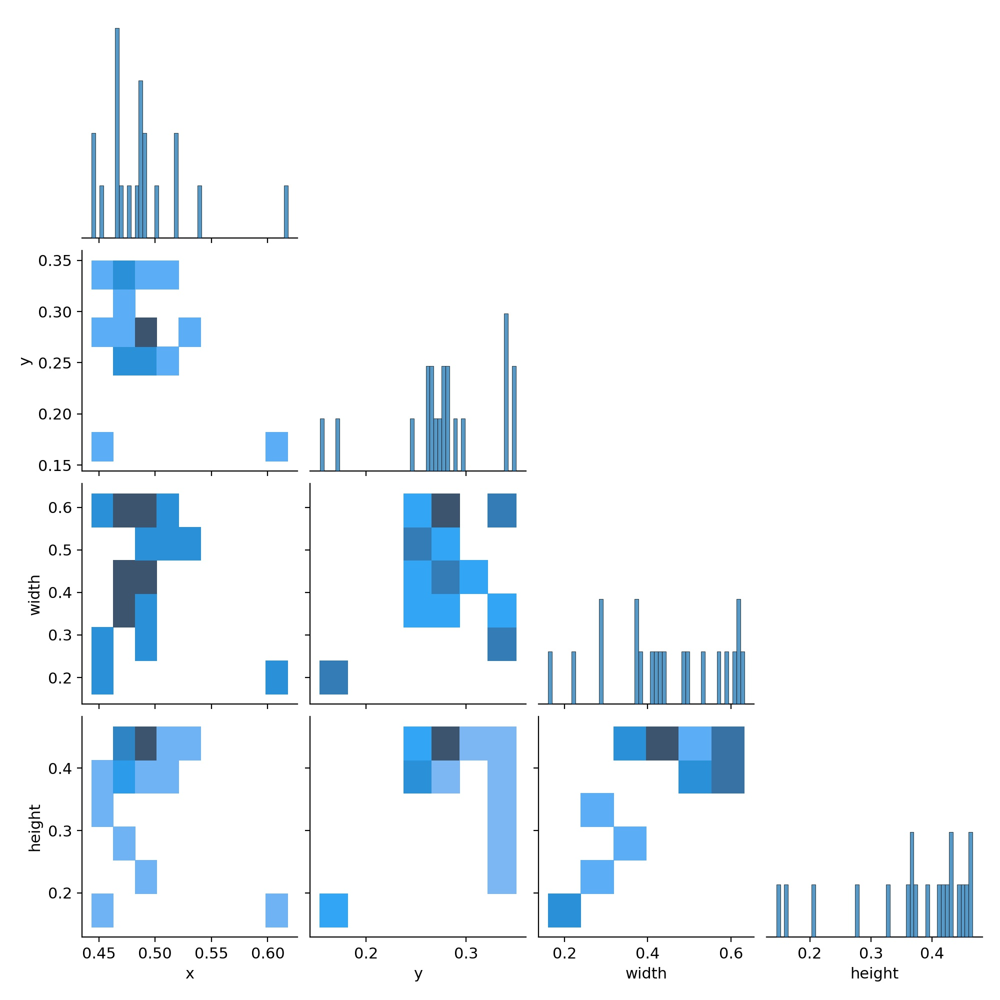

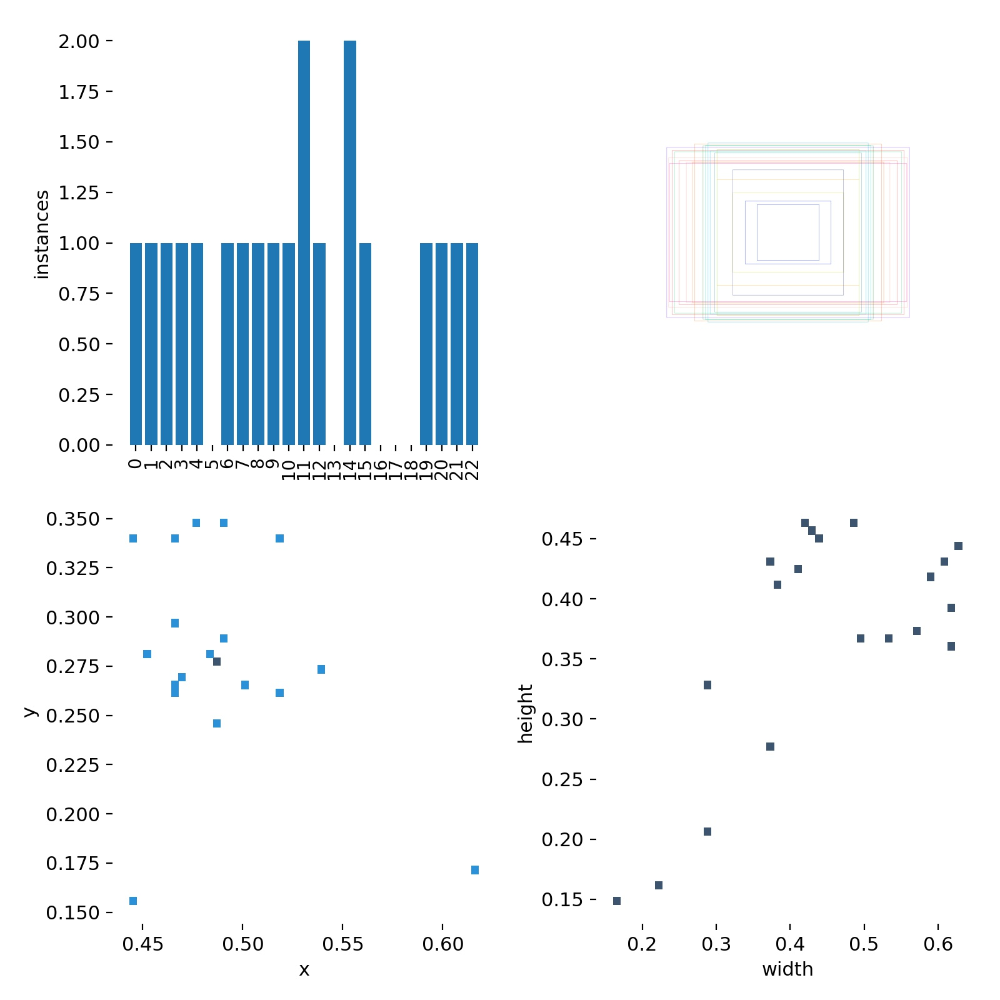

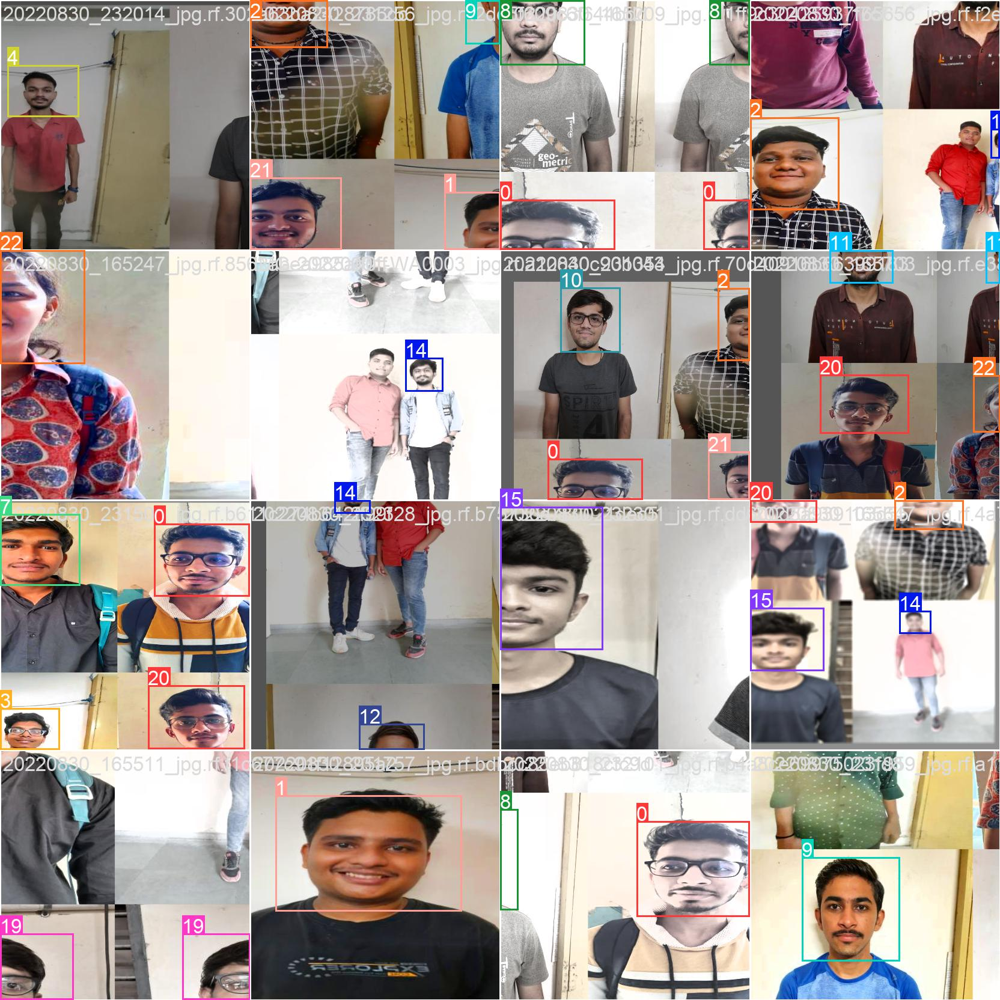

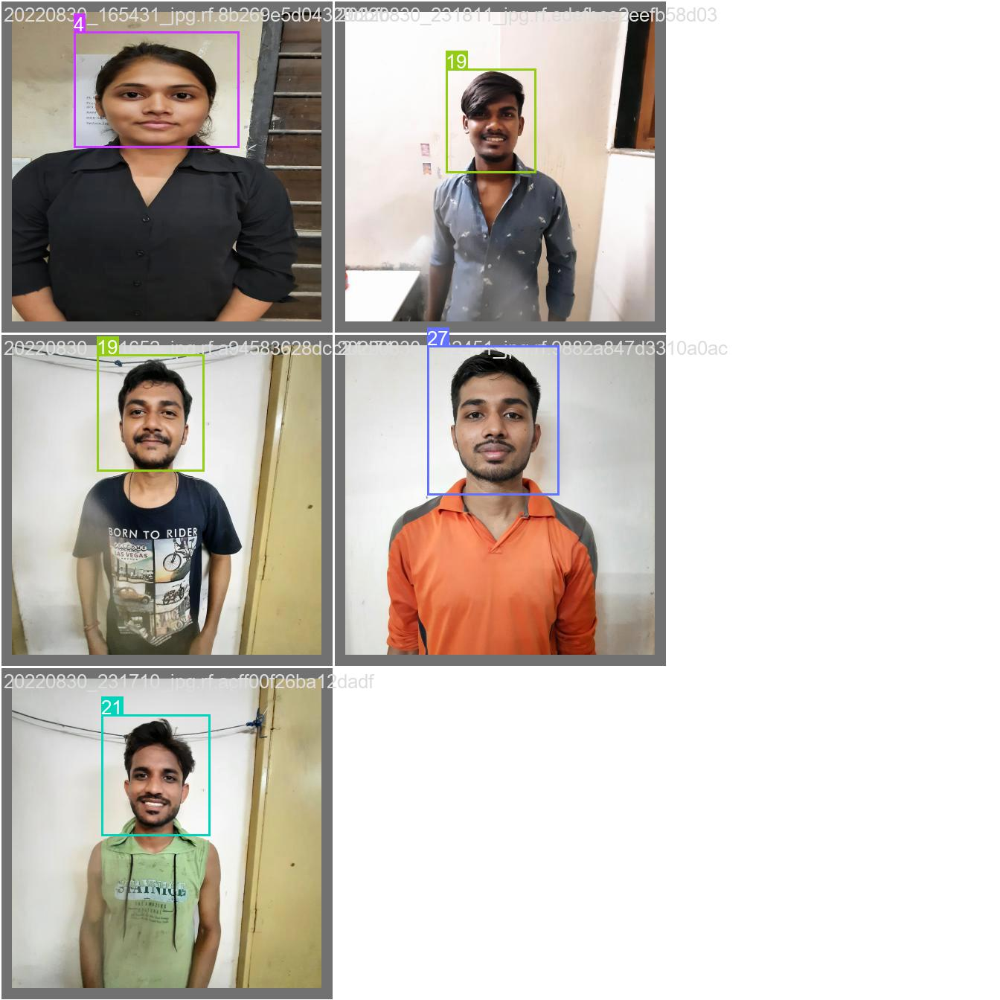

In [21]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/train/exp4/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [28]:
!python detect.py --weights runs/train/exp4/weights/best.pt --img 416 --conf 0.5 --source /content/datasets/gecp_project-1/train/images/

detect: weights=['runs/train/exp4/weights/best.pt'], source=/content/datasets/gecp_project-1/train/images/, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.5, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.2-82-gc91d1db Python-3.7.13 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 367 layers, 46226748 parameters, 0 gradients, 108.0 GFLOPs
image 1/20 /content/datasets/gecp_project-1/train/images/20220830_165209_jpg.rf.1ff9c30425937f7cfb7b2df4fb45dfc7.jpg: 416x416 (no detections), 30.5ms
image 2/20 /content/datasets/gecp_project-1/train/images/20220830_165247_jpg.rf.8562abea985aff0ff20710fbdbcd72d2.jpg: 416x416 (no detections), 30.5ms
image 3/20 /content/datasets/gec

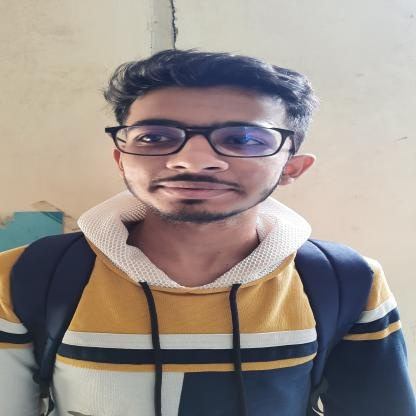

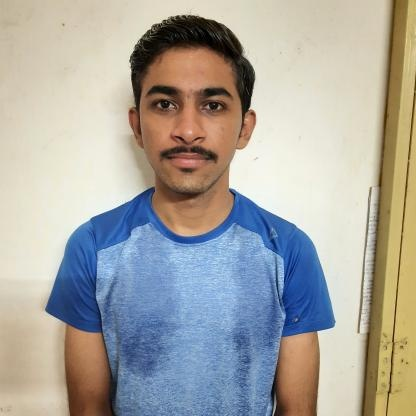

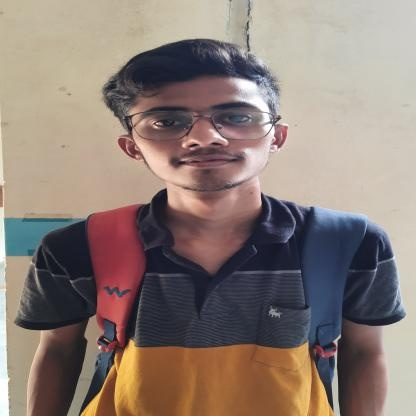

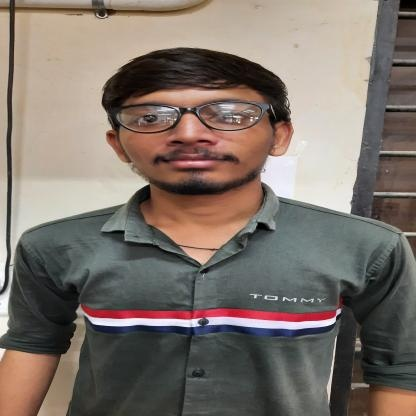

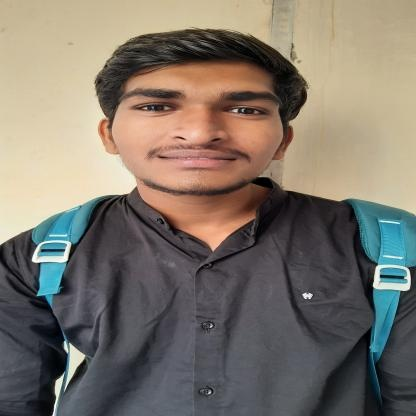

...

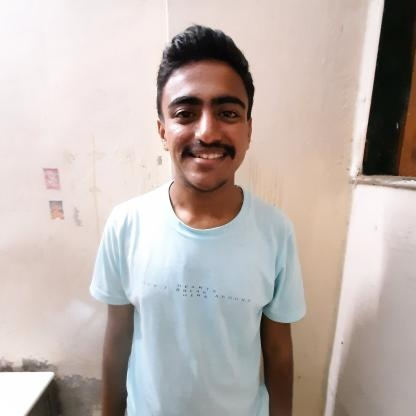

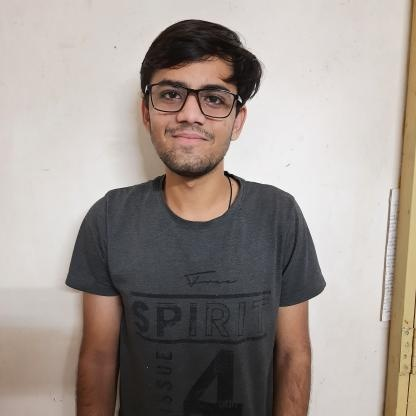

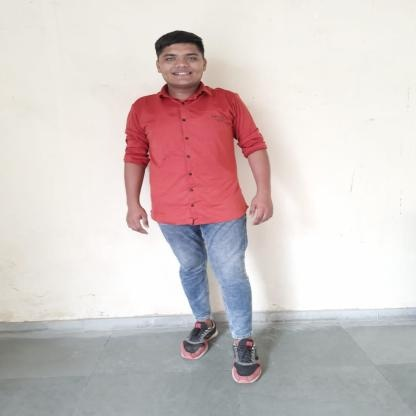

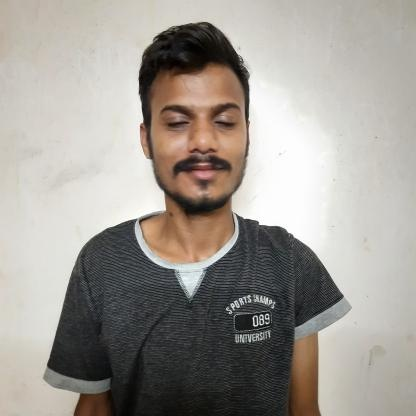

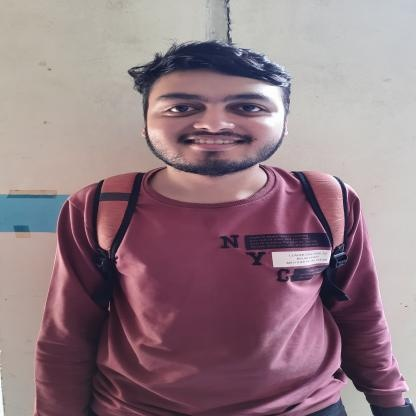

In [29]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp8/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [23]:
!python detect.py --weights runs/train/exp4/weights/best.pt --img 416 --conf 0.1 --source /content/yolov5/runs/detect/exp2

detect: weights=['runs/train/exp4/weights/best.pt'], source=/content/yolov5/runs/detect/exp2, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.2-82-gc91d1db Python-3.7.13 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 367 layers, 46226748 parameters, 0 gradients, 108.0 GFLOPs
image 1/1 /content/yolov5/runs/detect/exp2/ATT_FINAL.png: 416x288 6 28s, 27.6ms
Speed: 0.4ms pre-process, 27.6ms inference, 1.3ms NMS per image at shape (1, 3, 416, 416)
Results saved to runs/detect/exp7


In [27]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp7/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [30]:
!python train.py --img 416 --batch 16 --epochs 550 --data /content/datasets/gecp_project-1/data.yaml --weights yolov5l.pt --cach

train: weights=yolov5l.pt, cfg=, data=/content/datasets/gecp_project-1/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=550, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.2-82-gc91d1db Python-3.7.13 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h

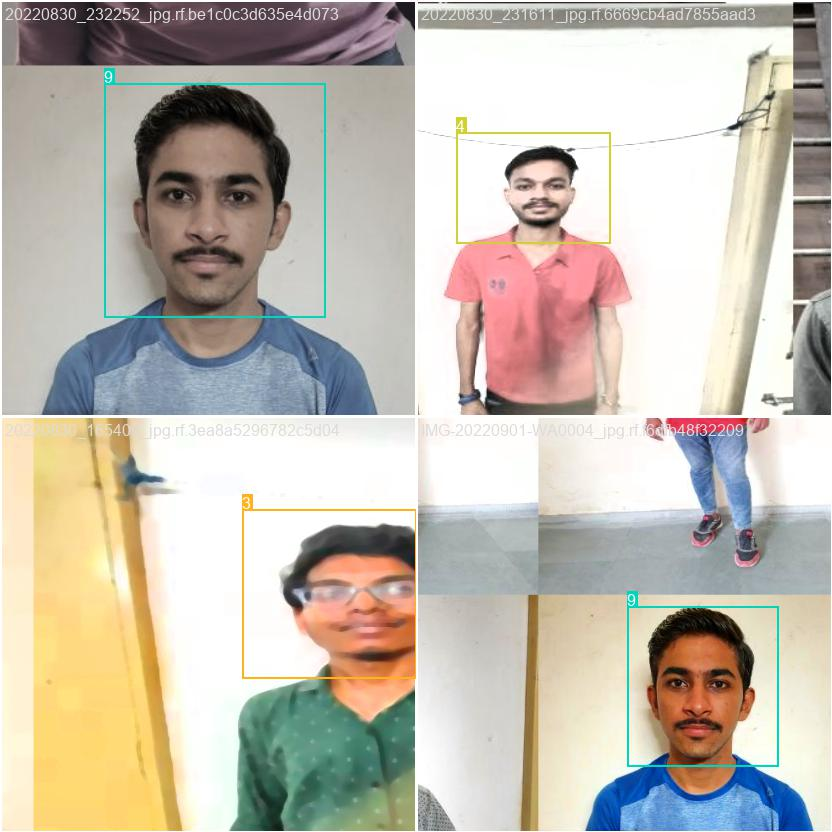

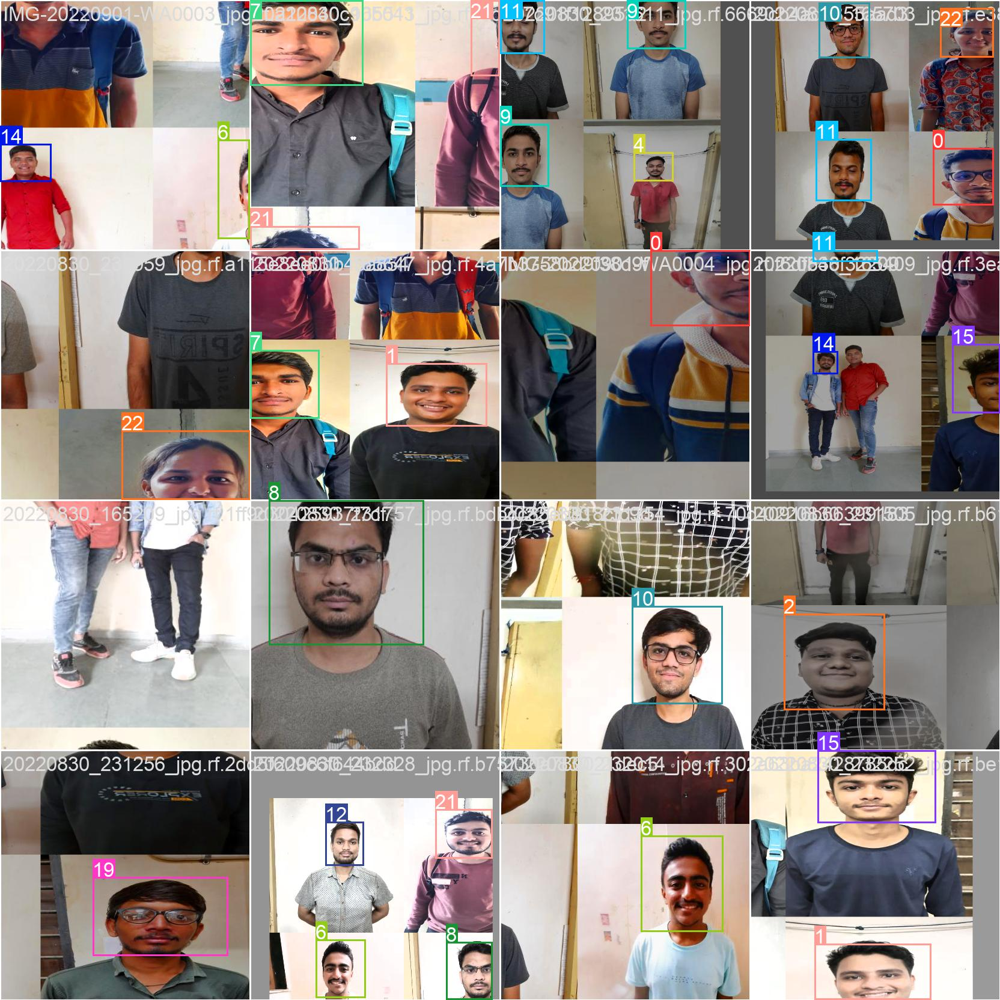

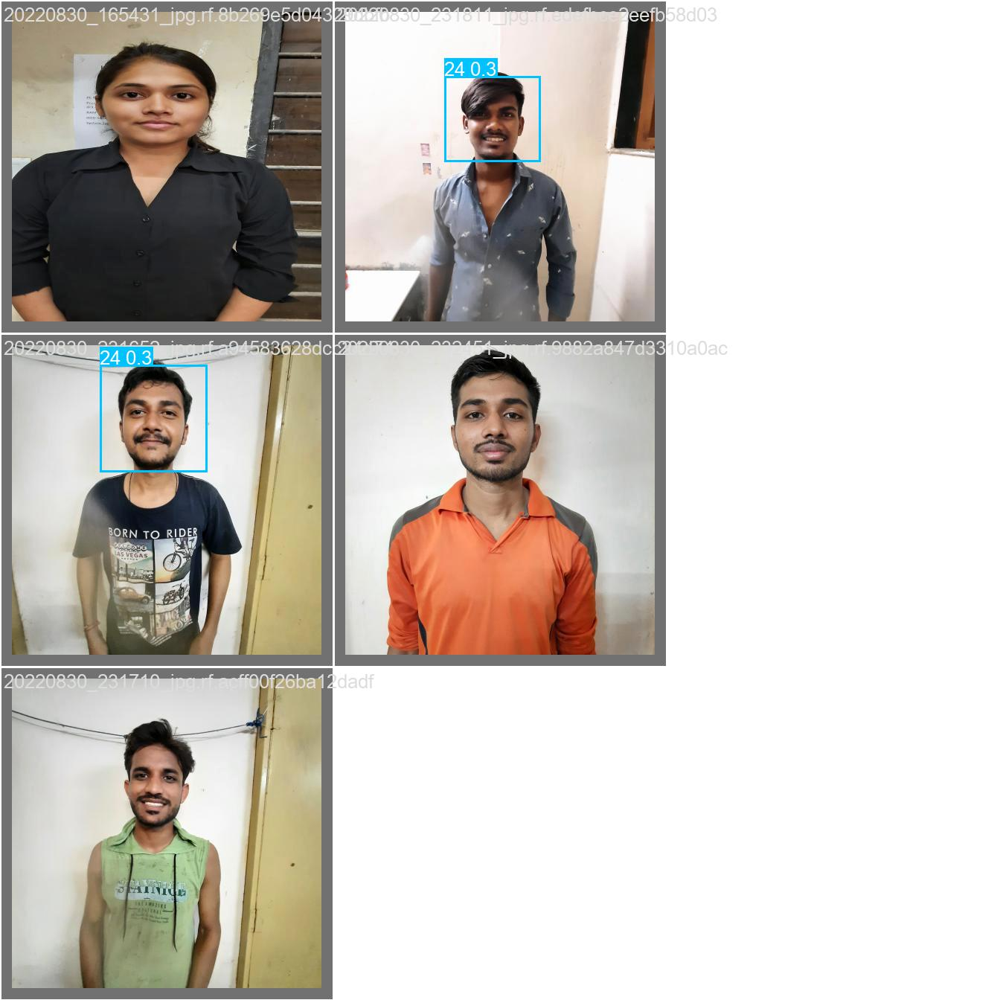

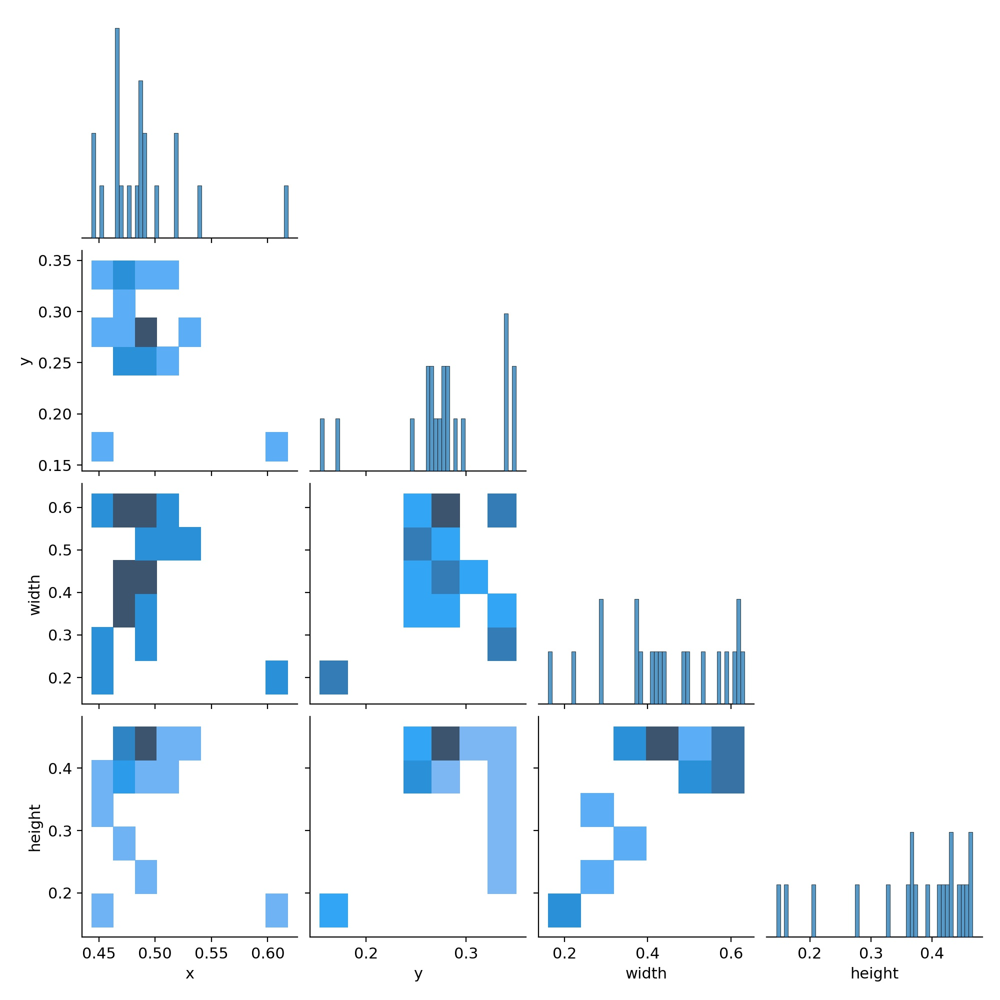

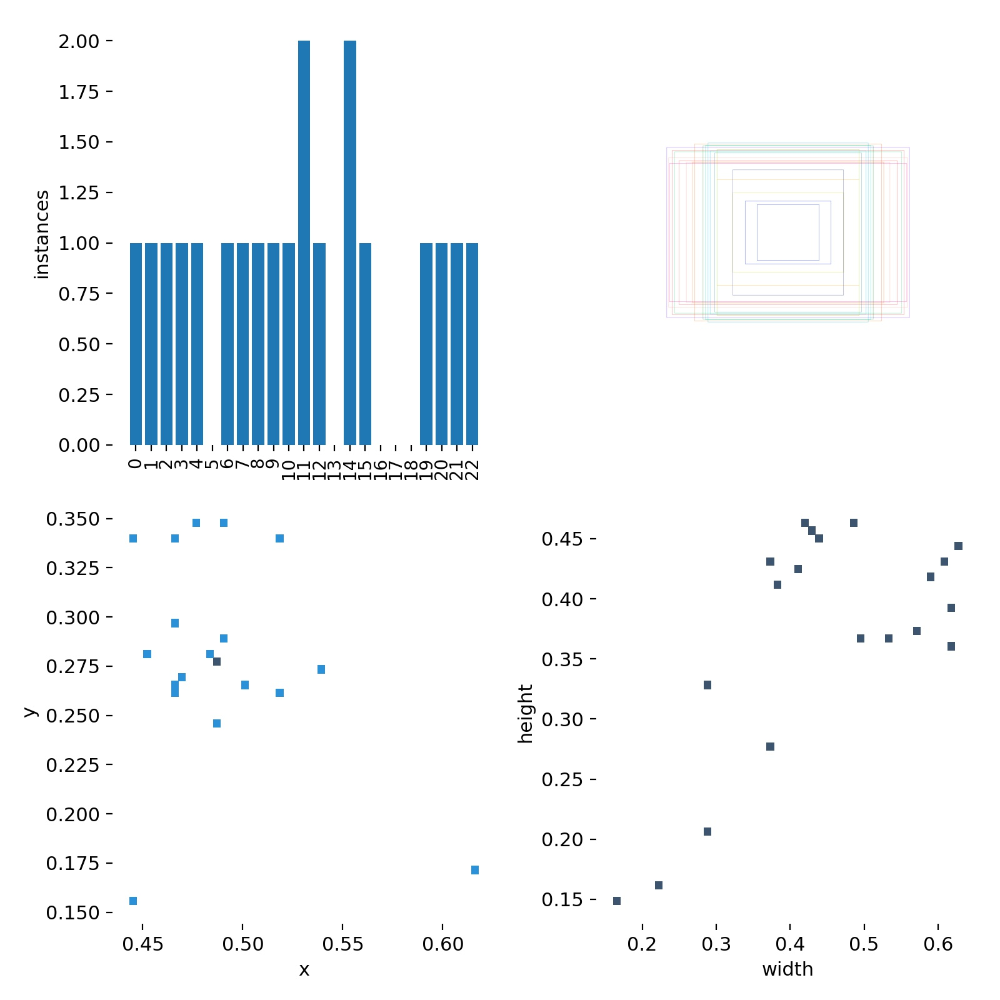

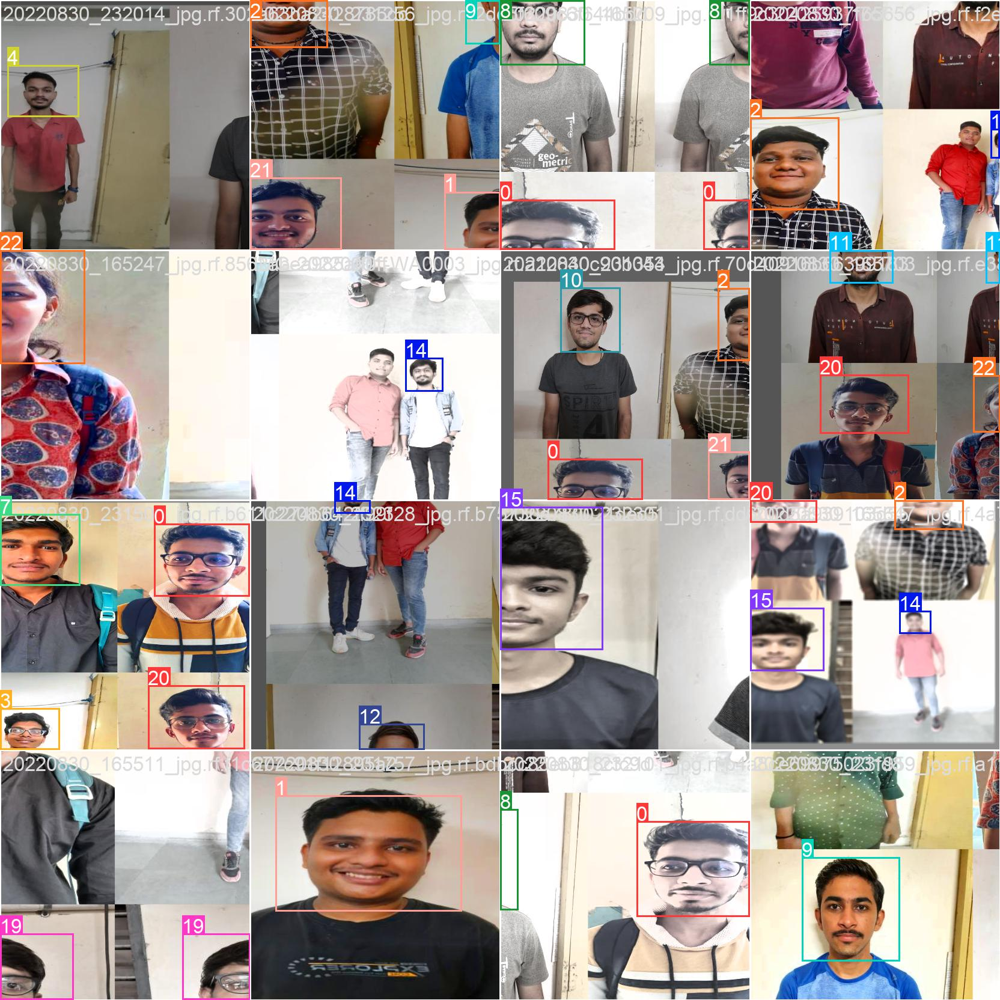

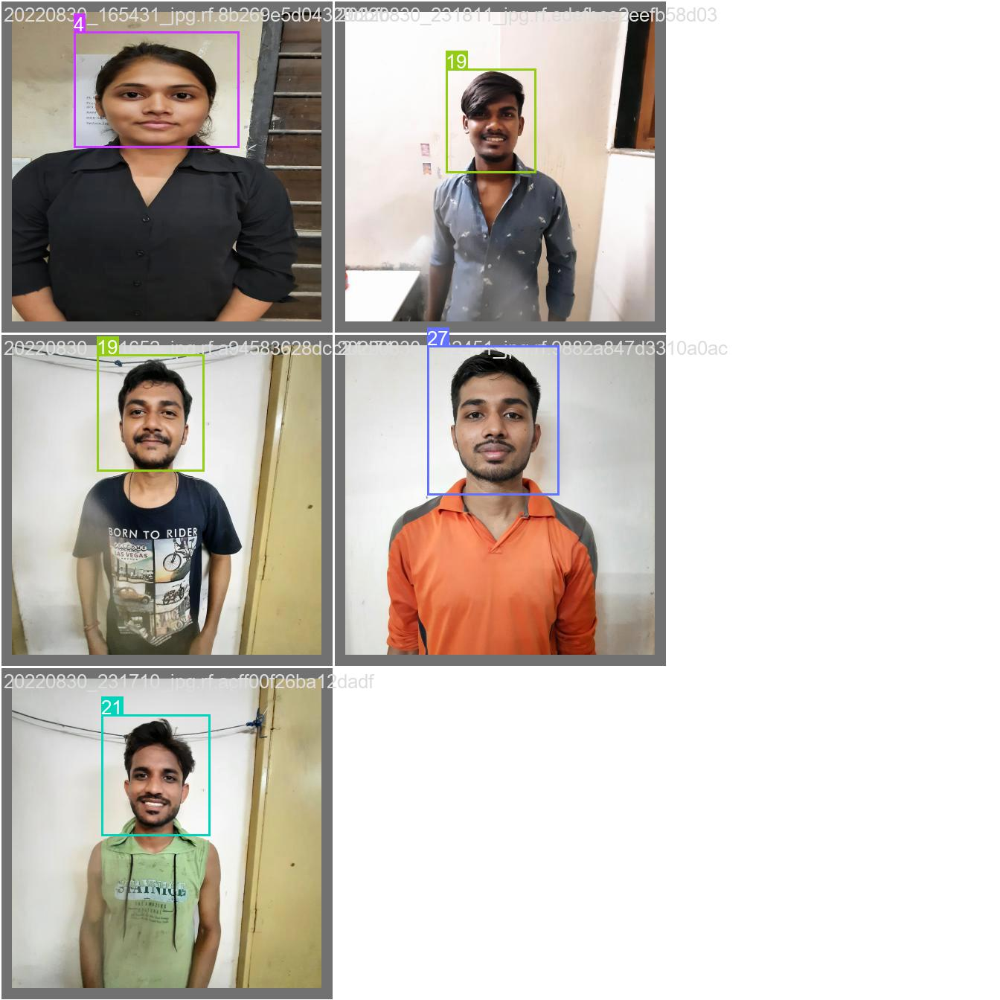

In [31]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/train/exp5/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

In [32]:
!python detect.py --weights runs/train/exp5/weights/best.pt --img 416 --conf 0.1 --source /content/datasets/gecp_project-1/train/images/

detect: weights=['runs/train/exp5/weights/best.pt'], source=/content/datasets/gecp_project-1/train/images/, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.2-82-gc91d1db Python-3.7.13 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 367 layers, 46226748 parameters, 0 gradients, 108.0 GFLOPs
image 1/20 /content/datasets/gecp_project-1/train/images/20220830_165209_jpg.rf.1ff9c30425937f7cfb7b2df4fb45dfc7.jpg: 416x416 1 1, 1 3, 30.6ms
image 2/20 /content/datasets/gecp_project-1/train/images/20220830_165247_jpg.rf.8562abea985aff0ff20710fbdbcd72d2.jpg: 416x416 1 3, 30.6ms
image 3/20 /content/datasets/gecp_project-1/train/i

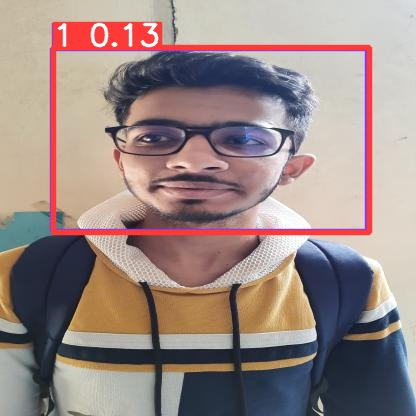

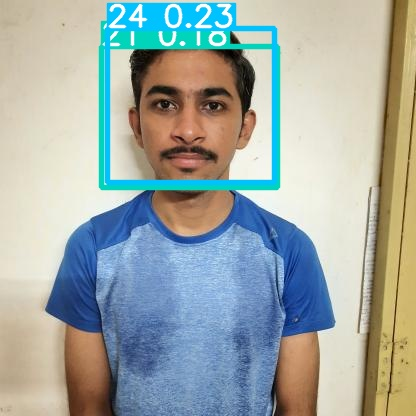

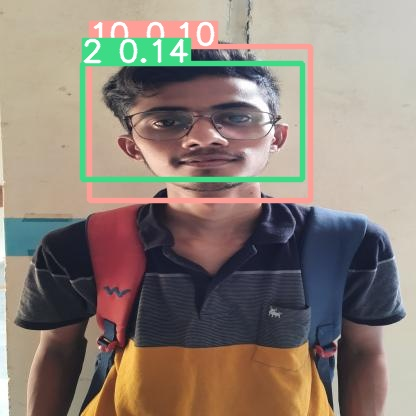

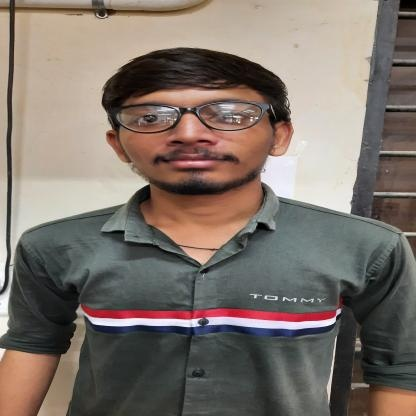

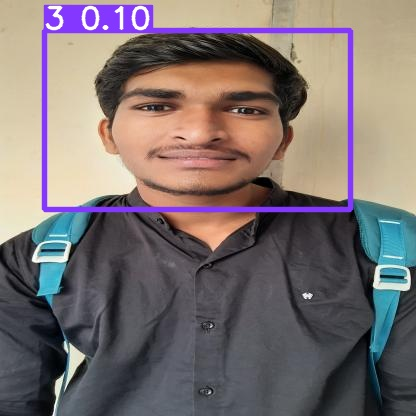

...

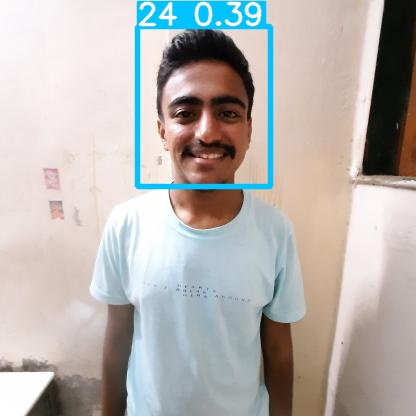

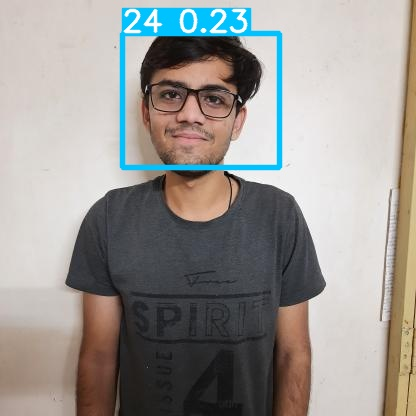

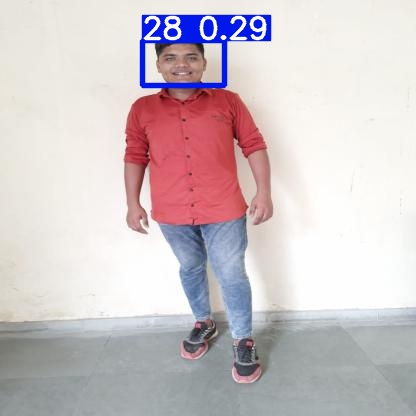

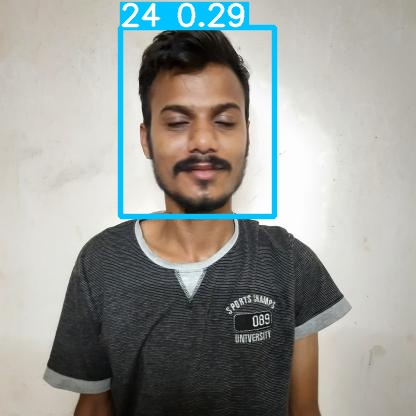

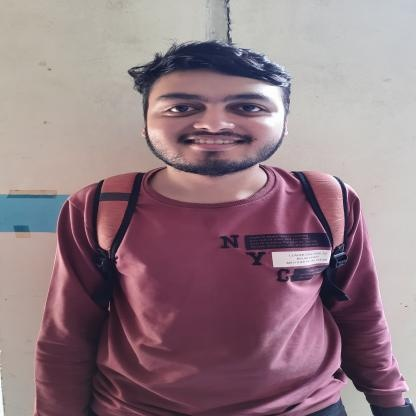

In [33]:
#display inference on ALL test images

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp9/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")